# Individual variability in functional organization - Additional analyses

## Load packages

In [1]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv
import math
from math import isnan
import statistics
import pingouin as pg
import pickle

# Computing / Analyses
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM
from statsmodels.stats.multitest import fdrcorrection # does not yield exactly the same FDR correction as R but the same up to 14th decimal place so good enough
import statsmodels.regression.mixed_linear_model as sm

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn
from brainstat.datasets import fetch_parcellation
from enigmatoolbox.permutation_testing import spin_test, shuf_test

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.2, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/28Me/data/'

resdir = '/data/p_02667/28Me/results/'
resdir_fig = resdir + 'figures/'

## Import functions

In [3]:
%run '/data/p_02667/28Me/scripts/p28Me_myfunctions.ipynb'

# Data

## Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)

In [4]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

yeo7_networks_array = np.genfromtxt(datadir+'yeo_7.csv', delimiter=',', skip_header=0)

In [5]:
# Sofie's 17 to 7 network conversion for Schaefer 400 (17 network) parcel order

yeo_17_2_7 = np.genfromtxt(datadir+'yeo_17_2_7.csv', delimiter=',')

### Define custom yeo 7 colormap

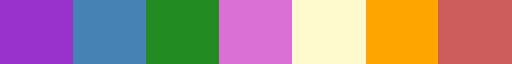

In [6]:
from matplotlib.colors import ListedColormap

# define custom colormap using color names (in order of corresponding networks: 1 visual, 2 sensorimotor, 3 dorsal attention, 4 ventral attention, 5 limbic, 6 fronto parietal, 7 DMN)
colors_yeo7 = ['darkorchid', 'steelblue', 'forestgreen', 'orchid', 'lemonchiffon', 'orange',  'indianred']

yeo7_colormap = ListedColormap(colors_yeo7, 'custom_colormap')

yeo7_colormap

### Plot on hemispheres

#### Schaefer 400 7 networks

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


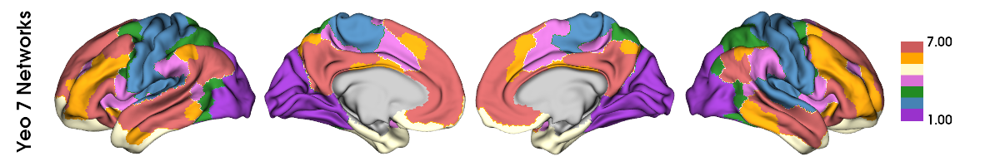

In [7]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan) 

plot_hemispheres(surf_lh, surf_rh, 
                 array_name=networks, 
                 embed_nb = True, 
                 size=(1200, 200), 
                 cmap= yeo7_colormap, 
                 color_bar=True, 
                 nan_color = (0.7, 0.7, 0.7, 1),
                 label_text=['Yeo 7 Networks'], 
                 zoom=1.55,
                 screenshot=False,
                 filename=resdir_fig+'plotted_hemispheres_yeo7.png')

#### Schaefer 400 17 to 7 networks, plotted in fs5 space

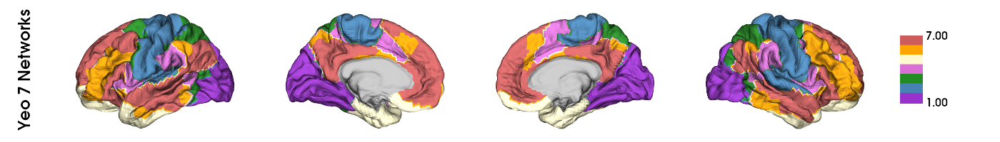

In [8]:
# convert network labels to fs5 space
yeo_17_2_7_fs5 = schaefer400_to_fs5(schaefer400_data = yeo_17_2_7, seven_networks=False)


# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = yeo_17_2_7_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = yeo7_colormap, 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["Yeo 7 Networks"],
    zoom = 1.45,
    screenshot=False,
    filename=resdir_fig+'plotted_hemispheres_yeo7.png')

In [9]:
# making an array with yeo network labels (names instead of numbers)
yeo_17_2_7_networks_array_labels = []

for i in yeo_17_2_7:
    if i == 1:
        yeo_17_2_7_networks_array_labels.append('visual')
    elif i == 2:
        yeo_17_2_7_networks_array_labels.append('sensory motor')
    elif i == 3:
        yeo_17_2_7_networks_array_labels.append('dorsal attention')
    elif i == 4:
        yeo_17_2_7_networks_array_labels.append('ventral attention')
    elif i == 5:
        yeo_17_2_7_networks_array_labels.append('limbic')
    elif i == 6:
        yeo_17_2_7_networks_array_labels.append('fronto parietal')
    elif i == 7:
        yeo_17_2_7_networks_array_labels.append('DMN')

yeo_17_2_7_networks_array_labels = np.asarray(yeo_17_2_7_networks_array_labels)

This palette is to be used for every time that Yeo networks are displayed in color (except (a) for showing the networks plotted on the hemispheres - this dictionary doesn't work as cmap for plot_hemispheres; (b) the pie charts - dictionary format not recognized)

In [10]:
# original Yeo network colors
palette_labeled_networks = {'DMN': 'indianred',  
                            'dorsal attention' : 'forestgreen',  
                            'fronto parietal' : 'orange',  
                            'limbic' : 'lemonchiffon',  
                            'sensory motor' : 'steelblue',
                            'ventral attention' : 'orchid', 
                            'visual' : 'darkorchid'} 

In [11]:
network_names = ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"]

print("Number of parcels in each Yeo network:")
for i in range(len(network_names)):
    print(f"- {network_names[i]}: {yeo_17_2_7_networks_array_labels.tolist().count(network_names[i])}")

Number of parcels in each Yeo network:
- visual: 61
- sensory motor: 77
- dorsal attention: 46
- ventral attention: 47
- limbic: 26
- fronto parietal: 53
- DMN: 90


## Fetch fsaverage parcellation (20484 vertices) coded for Schaefer 400 parcels - for Spin permutation tests

Spin permutation testing: https://enigma-toolbox.readthedocs.io/en/latest/pages/08.spintest/index.html -> requires data to be in fsaverage surface (not feasible with Schaefer parcellation)

**NOTE: schaefer_400_fs5 == 0 corresponds to midline (labels go from 0-400) -> disregard 0 in calculations and plotting**

In [12]:
# fetch the fsaverage parcellation labeling each of fsaverage5's 20484 vertices with its corresponding Schaefer parcel
schaefer_400_fs5 = fetch_parcellation("fsaverage5", "schaefer", 400)

## 28&Me functional matrices

In [13]:
path_list = os.listdir(datadir + 'coherence/coherence/28andMe/noGSR/')
path_list.sort()

In [14]:
fc_matrices = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + 'coherence/coherence/28andMe/noGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices.append(extracted_mat)
    
fc_matrices = np.array(fc_matrices)

In [15]:
fc_matrices.shape

(30, 400, 400)

## 28&He functional matrices

In [17]:
path_list = os.listdir(datadir + '28andHe_Coherence_withoutGSR/')
path_list.sort()

In [18]:
fc_matrices_He = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + '28andHe_Coherence_withoutGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices_He.append(extracted_mat)
    
fc_matrices_He = np.array(fc_matrices_He)

In [19]:
fc_matrices_He.shape

(40, 400, 400)

### Making AM and PM only arrays (following the hormone CSV file)

In [20]:
fc_matrices_He_AM = np.delete(fc_matrices_He, (11,13,15,17,19,21,23,25,27,29,30,31,32,33,34,35,36,37,38,39), axis=0)

In [21]:
fc_matrices_He_AM.shape

(20, 400, 400)

In [22]:
fc_matrices_He_PM = np.delete(fc_matrices_He, (0,1,2,3,4,5,6,7,8,9,10,12,14,16,18,20,22,24,26,28), axis=0)

In [23]:
fc_matrices_He_PM.shape

(20, 400, 400)

## 28&OC functional matrices

In [ ]:
path_list = os.listdir(datadir + 'coherence/coherence/28andOC/noGSR/')
path_list.sort()

In [ ]:
fc_matrices_OC = []

for file in path_list:
    
    # taking the FC matrices from the mat file (indexing within, then only taking the first 400 rows and columns because FC matrices include 15 additional subcortical areas
    extracted_mat = scipy.io.loadmat(datadir + 'coherence/coherence/28andOC/noGSR/'+file)['coherence'][0][0][0][0][0][0][:400,:400]
    
    # append the extracted mat file to list containing fc matrices
    fc_matrices_OC.append(extracted_mat)
    
fc_matrices_OC = np.array(fc_matrices_OC)

In [ ]:
fc_matrices_OC.shape

(30, 400, 400)

## Hormonal data

### 28 & Me

In [24]:
hormones = pd.read_excel(datadir+'28Hormones_LP_3_30_20.xlsx')
testosterone_28Me = pd.read_csv(datadir+'28MeTestosterone.csv')

hormones_28Me = hormones[hormones['Experiment'] == '28andMe']
hormones_28Me = hormones_28Me.rename(columns={"Estradiol (LCMS; pg/mL)": "estradiol", "Progesterone (LCMS; ng/mL)": "progesterone", "LH (mIU/ml)": "lh", "FSH (mIU/ml)": "fsh"})
hormones_28Me['testosterone'] = testosterone_28Me['testosterone']


# standardize hormone values for linear model
hormones_28Me['z_estradiol'] = (hormones_28Me.estradiol - np.mean(hormones_28Me.estradiol)) / np.std(hormones_28Me.estradiol)
hormones_28Me['z_progesterone'] = (hormones_28Me.progesterone - np.mean(hormones_28Me.progesterone)) / np.std(hormones_28Me.progesterone)
hormones_28Me['z_testosterone'] = (hormones_28Me.testosterone - np.mean(hormones_28Me.testosterone)) / np.std(hormones_28Me.testosterone)


# export to csv
hormones_28Me.to_csv(resdir+'hormones_28Me.csv', header = True, index = True)

# exclude day 26 because problem with functional data on that day
hormones_28Me_excl26 = hormones_28Me.drop(25)
hormones_28Me_excl26.to_csv(resdir+'hormones_28Me_excl26.csv', header = True, index = True)


# re-indexing order in menstrual cycle order -> from experimental day 11 -> (index 10)
hormones_28Me_MCreindexed = hormones_28Me.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_MCreindexed['MC day'] = list(range(1,31))

#### Behavior

In [27]:
behavior = pd.read_csv(datadir+'28behavioral.tsv', sep='\t')

behavior = behavior.rename(columns={"perceived_stress": "PSS"})

# get only Me data
behavior_28Me = behavior.iloc[:30, :]

# add Experiment column (for linear models)
behavior_28Me['Experiment'] = "28andMe"

# standardize hormone values for linear model
behavior_28Me['z_PSS'] = (behavior_28Me.PSS - np.mean(behavior_28Me.PSS)) / np.std(behavior_28Me.PSS)

# exclude day 26 because problem with functional data on that day
behavior_28Me_excl26 = behavior_28Me.drop(25)

# export to csv
behavior_28Me_excl26.to_csv(resdir+'behavior_28Me_excl26.csv', header = True, index = True)

/tmp/ipykernel_8006/484949236.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28Me['Experiment'] = "28andMe"
/tmp/ipykernel_8006/484949236.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28Me['z_PSS'] = (behavior_28Me.PSS - np.mean(behavior_28Me.PSS)) / np.std(behavior_28Me.PSS)


### 28 & He

In [28]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

In [29]:
hormones_28He.keys()

Index(['session', 'time', 'date (MM/DD/YY)', 'cortisol_serum',
       'cortisol_saliva', 'estradiol_serum', 'free_testosterone_serum',
       'total_testosterone_saliva', 'total_testosterone_serum', 'PSS_raw',
       'PSS_group', 'aggression', 'PSQI_score', 'STAI', 'POMS', 'POMS_tension',
       'POMS_depression', 'POMS_anger', 'POMS_vigor', 'POMS_fatigue',
       'POMS_confusion'],
      dtype='object')

In [30]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

hormones_28He_AM = hormones_28He[hormones_28He['time'] == 'Morning']
hormones_28He_PM = hormones_28He[hormones_28He['time'] == 'Evening']

# standardize hormone values for linear model
hormones_28He['z_total_testosterone_saliva'] = (hormones_28He.total_testosterone_saliva - np.mean(hormones_28He.total_testosterone_saliva)) / np.std(hormones_28He.total_testosterone_saliva)
hormones_28He_AM['z_total_testosterone_saliva'] = (hormones_28He_AM.total_testosterone_saliva - np.mean(hormones_28He_AM.total_testosterone_saliva)) / np.std(hormones_28He_AM.total_testosterone_saliva)
hormones_28He_PM['z_total_testosterone_saliva'] = (hormones_28He_PM.total_testosterone_saliva - np.mean(hormones_28He_PM.total_testosterone_saliva)) / np.std(hormones_28He_PM.total_testosterone_saliva)

hormones_28He['z_cortisol_saliva'] = (hormones_28He.cortisol_saliva - np.mean(hormones_28He.cortisol_saliva)) / np.std(hormones_28He.cortisol_saliva)
hormones_28He_AM['z_cortisol_saliva'] = (hormones_28He_AM.cortisol_saliva - np.mean(hormones_28He_AM.cortisol_saliva)) / np.std(hormones_28He_AM.cortisol_saliva)
hormones_28He_PM['z_cortisol_saliva'] = (hormones_28He_PM.cortisol_saliva - np.mean(hormones_28He_PM.cortisol_saliva)) / np.std(hormones_28He_PM.cortisol_saliva)

hormones_28He['z_estradiol_serum'] = (hormones_28He.estradiol_serum - np.mean(hormones_28He.estradiol_serum)) / np.std(hormones_28He.estradiol_serum)
hormones_28He_AM['z_estradiol_serum'] = (hormones_28He_AM.estradiol_serum - np.mean(hormones_28He_AM.estradiol_serum)) / np.std(hormones_28He_AM.estradiol_serum)
hormones_28He_PM['z_estradiol_serum'] = (hormones_28He_PM.estradiol_serum - np.mean(hormones_28He_PM.estradiol_serum)) / np.std(hormones_28He_PM.estradiol_serum)

hormones_28He['z_total_testosterone_serum'] = (hormones_28He.total_testosterone_serum - np.mean(hormones_28He.total_testosterone_serum)) / np.std(hormones_28He.total_testosterone_serum)
hormones_28He_AM['z_total_testosterone_serum'] = (hormones_28He_AM.total_testosterone_serum - np.mean(hormones_28He_AM.total_testosterone_serum)) / np.std(hormones_28He_AM.total_testosterone_serum)
hormones_28He_PM['z_total_testosterone_serum'] = (hormones_28He_PM.total_testosterone_serum - np.mean(hormones_28He_PM.total_testosterone_serum)) / np.std(hormones_28He_PM.total_testosterone_serum)


hormones_28He['z_PSS'] = (hormones_28He.PSS_raw - np.mean(hormones_28He.PSS_raw)) / np.std(hormones_28He.PSS_raw)
hormones_28He_AM['z_PSS'] = (hormones_28He_AM.PSS_raw - np.mean(hormones_28He_AM.PSS_raw)) / np.std(hormones_28He_AM.PSS_raw)
hormones_28He_PM['z_PSS'] = (hormones_28He_PM.PSS_raw - np.mean(hormones_28He_PM.PSS_raw)) / np.std(hormones_28He_PM.PSS_raw)


# export to csv
hormones_28He_AM.to_csv(resdir+'hormones_28He_AM.csv', header = True, index = True)
hormones_28He_PM.to_csv(resdir+'hormones_28He_PM.csv', header = True, index = True)

/tmp/ipykernel_8006/2322074335.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28He_AM['z_total_testosterone_saliva'] = (hormones_28He_AM.total_testosterone_saliva - np.mean(hormones_28He_AM.total_testosterone_saliva)) / np.std(hormones_28He_AM.total_testosterone_saliva)
/tmp/ipykernel_8006/2322074335.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28He_PM['z_total_testosterone_saliva'] = (hormones_28He_PM.total_testosterone_saliva - np.mean(hormones_28He_PM.total_testosterone_sali

### 28 & OC

In [ ]:
hormones_28OC = hormones[hormones['Experiment'] == '28andOC']
hormones_28OC = hormones_28OC.rename(columns={"Estradiol (LCMS; pg/mL)": "estradiol", "Progesterone (LCMS; ng/mL)": "progesterone", "LH (mIU/ml)": "lh", "FSH (mIU/ml)": "fsh"})


# standardize hormone values for linear model
hormones_28OC['z_estradiol'] = (hormones_28OC.estradiol - np.mean(hormones_28OC.estradiol)) / np.std(hormones_28OC.estradiol)
hormones_28OC['z_progesterone'] = (hormones_28OC.progesterone - np.mean(hormones_28OC.progesterone)) / np.std(hormones_28OC.progesterone)

# export to csv
hormones_28OC.to_csv(resdir+'hormones_28OC.csv', header = True, index = True)


# re-indexing order in menstrual cycle order (for some displays) -> from experimental day 14 -> (index 13)
hormones_28OC_MCreindexed = hormones_28OC.reindex(list(range(43,60))+list(range(30,43)))
hormones_28OC_MCreindexed['MC day'] = list(range(1,31))

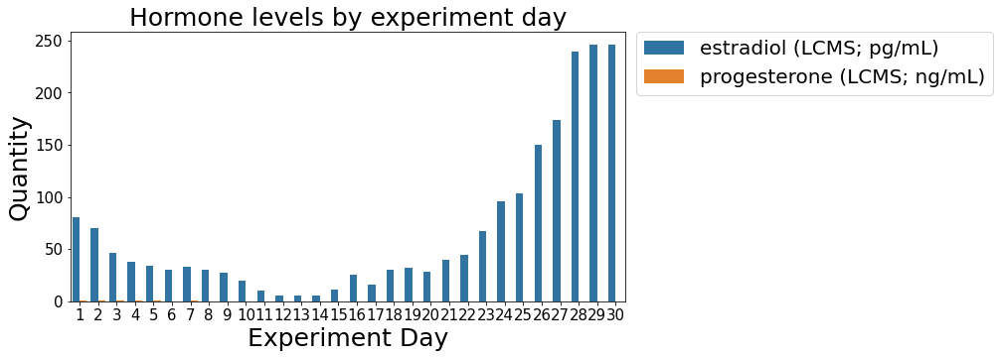

In [ ]:
dict_hormones = {'estradiol (LCMS; pg/mL)': hormones_28OC.estradiol, 
                 'progesterone (LCMS; ng/mL)': hormones_28OC.progesterone, 
                 'ExperimentDay': hormones_28OC.ExperimentDay}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['ExperimentDay'], value_vars=['estradiol (LCMS; pg/mL)', 'progesterone (LCMS; ng/mL)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="ExperimentDay", y='quantity', hue='hormone')

ax.set_title('Hormone levels by experiment day', fontsize=25);
ax.set_xlabel('Experiment Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


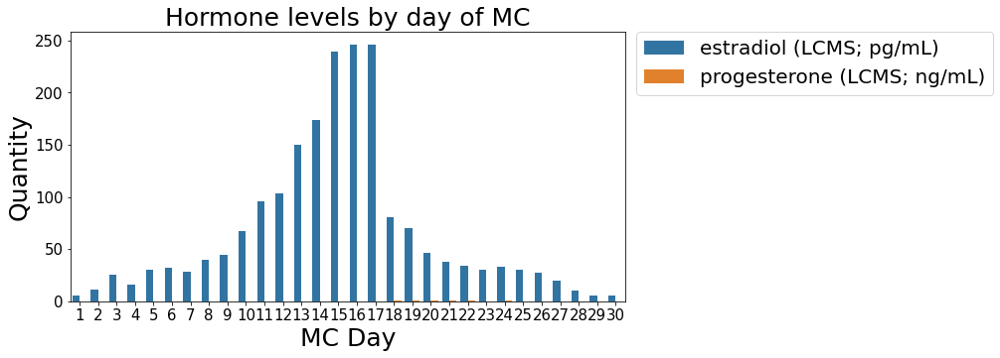

In [ ]:
dict_hormones = {'estradiol (LCMS; pg/mL)': hormones_28OC_MCreindexed.estradiol, 
                 'progesterone (LCMS; ng/mL)': hormones_28OC_MCreindexed.progesterone, 
                 'MC day': hormones_28OC_MCreindexed['MC day']}

df_hormones = pd.DataFrame(dict_hormones)

df_hormones_long = pd.melt(df_hormones, id_vars=['MC day'], value_vars=['estradiol (LCMS; pg/mL)', 'progesterone (LCMS; ng/mL)'], var_name='hormone', value_name='quantity')


### Plot 

fig, ax = plt.subplots(figsize=(10,5));

ax = sns.barplot(data=df_hormones_long, x="MC day", y='quantity', hue='hormone')

ax.set_title('Hormone levels by day of MC', fontsize=25);
ax.set_xlabel('MC Day', fontsize=25);
ax.set_ylabel('Quantity', fontsize=25);
ax.tick_params(labelsize=15);


ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


#### Behavior

In [ ]:
# get only OC data
behavior_28OC = behavior.iloc[30:, :]

# add Experiment column (for linear models)
behavior_28OC['Experiment'] = "28andOC"

# standardize hormone values for linear model
behavior_28OC['z_PSS'] = (behavior_28OC.PSS - np.mean(behavior_28OC.PSS)) / np.std(behavior_28OC.PSS)

# export to csv
behavior_28OC.to_csv(resdir+'behavior_28OC.csv', header = True, index = True)

/tmp/ipykernel_142252/2748703828.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28OC['Experiment'] = "28andOC"
/tmp/ipykernel_142252/2748703828.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28OC['z_PSS'] = (behavior_28OC.PSS - np.mean(behavior_28OC.PSS)) / np.std(behavior_28OC.PSS)


## Hormonal data

### 28 & Me

In [24]:
hormones = pd.read_excel(datadir+'28Hormones_LP_3_30_20.xlsx')
testosterone_28Me = pd.read_csv(datadir+'28MeTestosterone.csv')

hormones_28Me = hormones[hormones['Experiment'] == '28andMe']
hormones_28Me = hormones_28Me.rename(columns={"Estradiol (LCMS; pg/mL)": "estradiol", "Progesterone (LCMS; ng/mL)": "progesterone", "LH (mIU/ml)": "lh", "FSH (mIU/ml)": "fsh"})
hormones_28Me['testosterone'] = testosterone_28Me['testosterone']


# standardize hormone values for linear model
hormones_28Me['z_estradiol'] = (hormones_28Me.estradiol - np.mean(hormones_28Me.estradiol)) / np.std(hormones_28Me.estradiol)
hormones_28Me['z_progesterone'] = (hormones_28Me.progesterone - np.mean(hormones_28Me.progesterone)) / np.std(hormones_28Me.progesterone)
hormones_28Me['z_testosterone'] = (hormones_28Me.testosterone - np.mean(hormones_28Me.testosterone)) / np.std(hormones_28Me.testosterone)


# export to csv
hormones_28Me.to_csv(resdir+'hormones_28Me.csv', header = True, index = True)

# exclude day 26 because problem with functional data on that day
hormones_28Me_excl26 = hormones_28Me.drop(25)
hormones_28Me_excl26.to_csv(resdir+'hormones_28Me_excl26.csv', header = True, index = True)


# re-indexing order in menstrual cycle order -> from experimental day 11 -> (index 10)
hormones_28Me_MCreindexed = hormones_28Me.reindex(list(range(10,30))+list(range(0,10)))
hormones_28Me_MCreindexed['MC day'] = list(range(1,31))

#### Behavior

In [27]:
behavior = pd.read_csv(datadir+'28behavioral.tsv', sep='\t')

behavior = behavior.rename(columns={"perceived_stress": "PSS"})

# get only Me data
behavior_28Me = behavior.iloc[:30, :]

# add Experiment column (for linear models)
behavior_28Me['Experiment'] = "28andMe"

# standardize hormone values for linear model
behavior_28Me['z_PSS'] = (behavior_28Me.PSS - np.mean(behavior_28Me.PSS)) / np.std(behavior_28Me.PSS)

# exclude day 26 because problem with functional data on that day
behavior_28Me_excl26 = behavior_28Me.drop(25)

# export to csv
behavior_28Me_excl26.to_csv(resdir+'behavior_28Me_excl26.csv', header = True, index = True)

/tmp/ipykernel_8006/484949236.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28Me['Experiment'] = "28andMe"
/tmp/ipykernel_8006/484949236.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  behavior_28Me['z_PSS'] = (behavior_28Me.PSS - np.mean(behavior_28Me.PSS)) / np.std(behavior_28Me.PSS)


### 28 & He

In [28]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

In [29]:
hormones_28He.keys()

Index(['session', 'time', 'date (MM/DD/YY)', 'cortisol_serum',
       'cortisol_saliva', 'estradiol_serum', 'free_testosterone_serum',
       'total_testosterone_saliva', 'total_testosterone_serum', 'PSS_raw',
       'PSS_group', 'aggression', 'PSQI_score', 'STAI', 'POMS', 'POMS_tension',
       'POMS_depression', 'POMS_anger', 'POMS_vigor', 'POMS_fatigue',
       'POMS_confusion'],
      dtype='object')

In [30]:
hormones_28He = pd.read_csv(datadir+'28andHe_behavior.csv')

hormones_28He_AM = hormones_28He[hormones_28He['time'] == 'Morning']
hormones_28He_PM = hormones_28He[hormones_28He['time'] == 'Evening']

# standardize hormone values for linear model
hormones_28He['z_total_testosterone_saliva'] = (hormones_28He.total_testosterone_saliva - np.mean(hormones_28He.total_testosterone_saliva)) / np.std(hormones_28He.total_testosterone_saliva)
hormones_28He_AM['z_total_testosterone_saliva'] = (hormones_28He_AM.total_testosterone_saliva - np.mean(hormones_28He_AM.total_testosterone_saliva)) / np.std(hormones_28He_AM.total_testosterone_saliva)
hormones_28He_PM['z_total_testosterone_saliva'] = (hormones_28He_PM.total_testosterone_saliva - np.mean(hormones_28He_PM.total_testosterone_saliva)) / np.std(hormones_28He_PM.total_testosterone_saliva)

hormones_28He['z_cortisol_saliva'] = (hormones_28He.cortisol_saliva - np.mean(hormones_28He.cortisol_saliva)) / np.std(hormones_28He.cortisol_saliva)
hormones_28He_AM['z_cortisol_saliva'] = (hormones_28He_AM.cortisol_saliva - np.mean(hormones_28He_AM.cortisol_saliva)) / np.std(hormones_28He_AM.cortisol_saliva)
hormones_28He_PM['z_cortisol_saliva'] = (hormones_28He_PM.cortisol_saliva - np.mean(hormones_28He_PM.cortisol_saliva)) / np.std(hormones_28He_PM.cortisol_saliva)

hormones_28He['z_estradiol_serum'] = (hormones_28He.estradiol_serum - np.mean(hormones_28He.estradiol_serum)) / np.std(hormones_28He.estradiol_serum)
hormones_28He_AM['z_estradiol_serum'] = (hormones_28He_AM.estradiol_serum - np.mean(hormones_28He_AM.estradiol_serum)) / np.std(hormones_28He_AM.estradiol_serum)
hormones_28He_PM['z_estradiol_serum'] = (hormones_28He_PM.estradiol_serum - np.mean(hormones_28He_PM.estradiol_serum)) / np.std(hormones_28He_PM.estradiol_serum)

hormones_28He['z_total_testosterone_serum'] = (hormones_28He.total_testosterone_serum - np.mean(hormones_28He.total_testosterone_serum)) / np.std(hormones_28He.total_testosterone_serum)
hormones_28He_AM['z_total_testosterone_serum'] = (hormones_28He_AM.total_testosterone_serum - np.mean(hormones_28He_AM.total_testosterone_serum)) / np.std(hormones_28He_AM.total_testosterone_serum)
hormones_28He_PM['z_total_testosterone_serum'] = (hormones_28He_PM.total_testosterone_serum - np.mean(hormones_28He_PM.total_testosterone_serum)) / np.std(hormones_28He_PM.total_testosterone_serum)


hormones_28He['z_PSS'] = (hormones_28He.PSS_raw - np.mean(hormones_28He.PSS_raw)) / np.std(hormones_28He.PSS_raw)
hormones_28He_AM['z_PSS'] = (hormones_28He_AM.PSS_raw - np.mean(hormones_28He_AM.PSS_raw)) / np.std(hormones_28He_AM.PSS_raw)
hormones_28He_PM['z_PSS'] = (hormones_28He_PM.PSS_raw - np.mean(hormones_28He_PM.PSS_raw)) / np.std(hormones_28He_PM.PSS_raw)


# export to csv
hormones_28He_AM.to_csv(resdir+'hormones_28He_AM.csv', header = True, index = True)
hormones_28He_PM.to_csv(resdir+'hormones_28He_PM.csv', header = True, index = True)

/tmp/ipykernel_8006/2322074335.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28He_AM['z_total_testosterone_saliva'] = (hormones_28He_AM.total_testosterone_saliva - np.mean(hormones_28He_AM.total_testosterone_saliva)) / np.std(hormones_28He_AM.total_testosterone_saliva)
/tmp/ipykernel_8006/2322074335.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hormones_28He_PM['z_total_testosterone_saliva'] = (hormones_28He_PM.total_testosterone_saliva - np.mean(hormones_28He_PM.total_testosterone_sali

# 28&OC 

## Building gradients (OC)

### Mean gradient

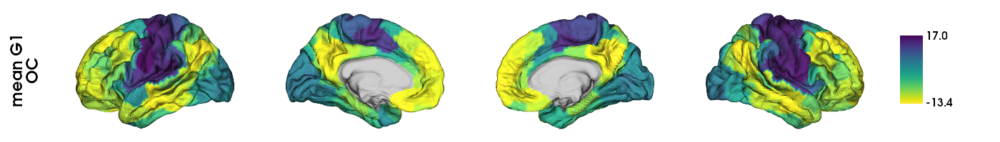

In [54]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_OC = sum(fc_matrices_OC)/len(fc_matrices_OC)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_OC = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_OC = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_OC.fit(mean_fc_matrix_OC)

# mean G1
mean_fc_G1_OC = mean_fc_grad_OC.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_OC_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_OC, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_OC_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nOC"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'OC_mean_G1.png')

plotted_hemispheres

### Aligned gradients

In [55]:
compute_aligned_grad_OC = compute_aligned_gradients(fc_matrices_OC, mean_fc_grad_OC.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_OC_G1 = compute_aligned_grad_OC['array_aligned_G1']

#### Export gradient to csv for R and dispersion analyses

In [56]:
# fmt = decimals, 
# header = str(list(range(1,401)))[1:-1] ->header = 1 to 400 (without the first and last string letter because it's the [] of the list -> only use for R export, np.genfromtxt will read it as an additional line which is wrong
# comments = empty because otherwise gives a #

np.savetxt(resdir+'array_aligned_fc_OC_G1.csv', array_aligned_fc_OC_G1, delimiter=',', fmt = '%.16g', comments = '')

#### Reindex from experimental day 14 -> (index 13) in order to put in MC day format

In [57]:
array_aligned_fc_OC_G1_MCreindexed = np.concatenate((array_aligned_fc_OC_G1[13:], array_aligned_fc_OC_G1[:13]))

## Differences in variability

### Me vs OC 
-> no differences in variability

Number of parcels for which there males have a statistically significant larger variance than females: 3
Number of parcels for which there females have a statistically significant larger variance than males: 17
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 0
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.02; Females = 1.421
Maximum SD: Males = 5.888; Females = 4.916


/tmp/ipykernel_218281/3483680755.py:92: RuntimeWarning: All-NaN slice encountered
  color_range_custom = (0, np.nanmax(std_grad_fdr_corr_levene_sig_sexdiff))
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


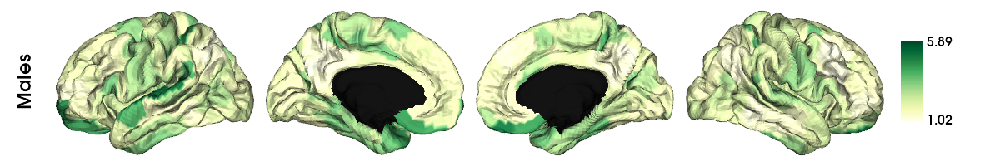

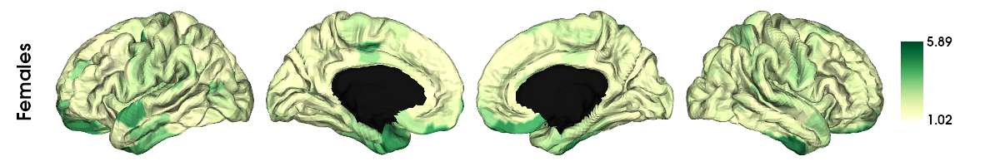

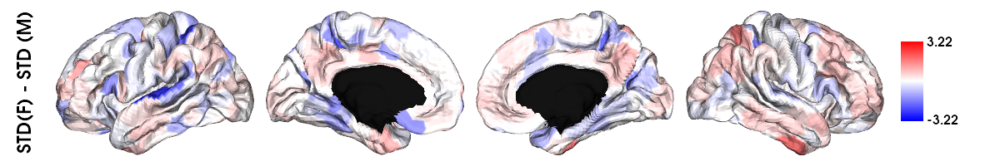

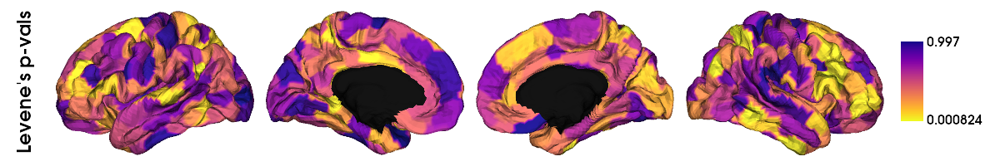

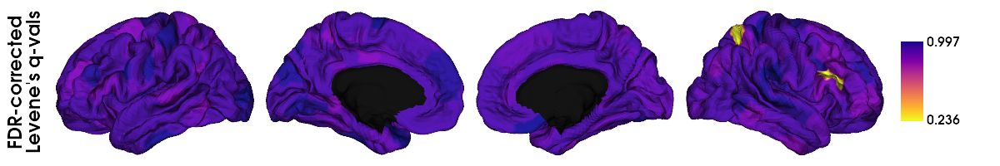

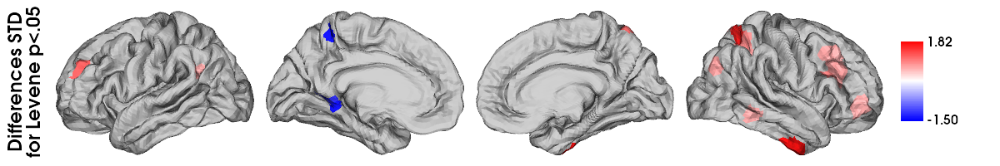

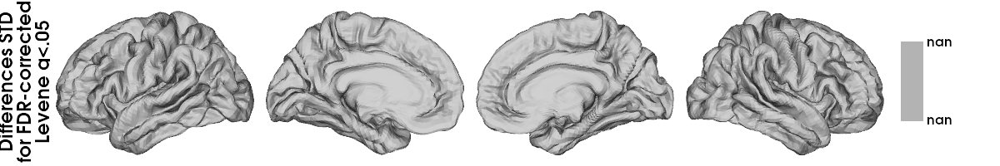

Number of significant parcels: 0

Number of significant parcels for males: 0
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):


ZeroDivisionError: division by zero

In [72]:
diff_std_Me_OC = variability_parcel_std(subject_grad_M=array_aligned_fc_OC_G1, subject_grad_F=array_aligned_fc_G1_excl26, sample_modality='Me_OC', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


### OC vs He (AM)

Number of parcels for which there males have a statistically significant larger variance than females: 119
Number of parcels for which there females have a statistically significant larger variance than males: 5
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 80
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 1

Minimum SD: Males = 1.399; Females = 1.02
Maximum SD: Males = 5.247; Females = 5.888


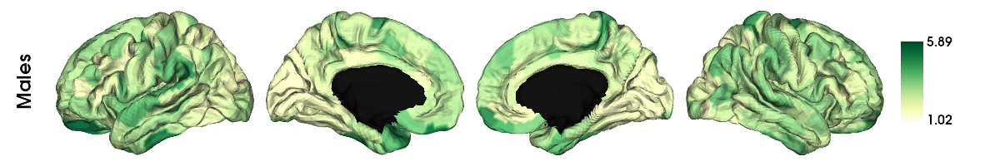

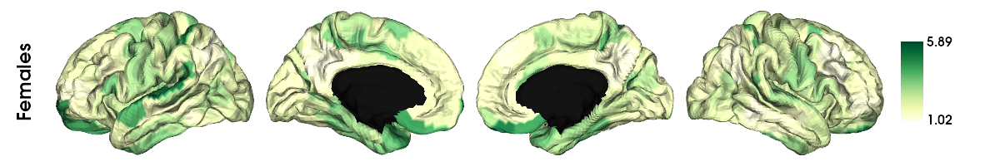

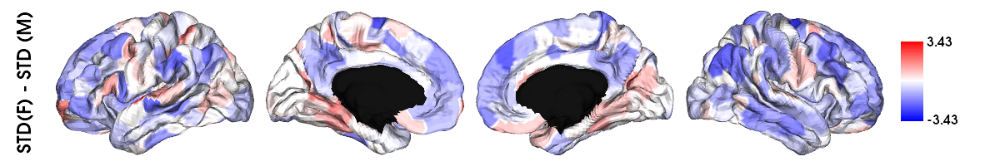

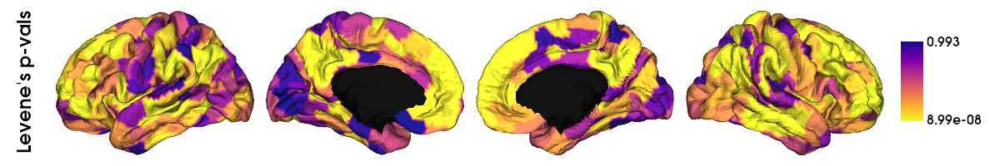

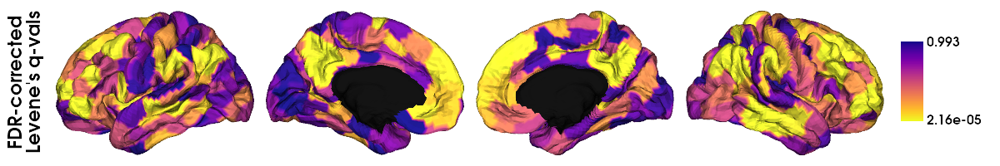

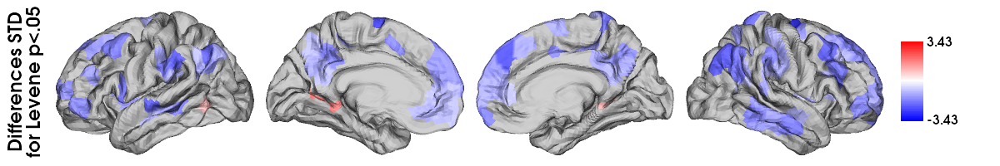

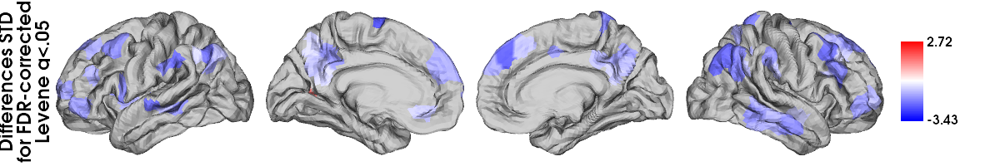

Number of significant parcels: 81

Number of significant parcels for males: 80
Number of significant parcels for females: 1

Number of significant parcels in each Yeo network (across sexes):
- visual: 1 out of 61 (1.64%) -> 1.23% of overall significance
- sensory motor: 4 out of 77 (5.19%) -> 4.94% of overall significance
- DMN: 36 out of 46 (78.26%) -> 44.44% of overall significance
- dorsal attention: 6 out of 47 (12.77%) -> 7.41% of overall significance
- ventral attention: 13 out of 26 (50.0%) -> 16.05% of overall significance
- limbic: 0 out of 53 (0.0%) -> 0.0% of overall significance
- fronto parietal: 21 out of 90 (23.33%) -> 25.93% of overall significance





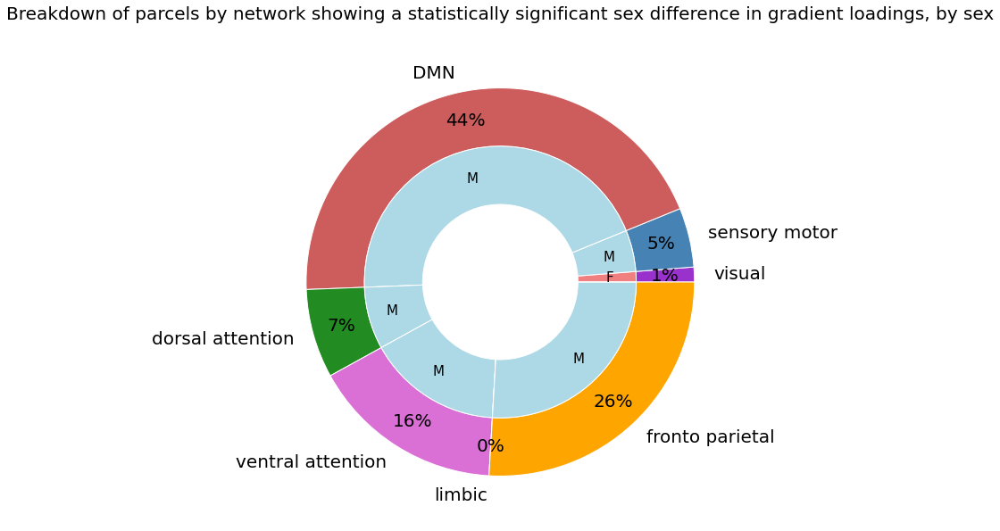

Number of significant parcels by sex:
visual - Male: 0, Female: 1
sensory motor - Male: 4, Female: 0
DMN - Male: 36, Female: 0
dorsal attention - Male: 6, Female: 0
ventral attention - Male: 13, Female: 0
limbic - Male: 0, Female: 0
fronto parietal - Male: 21, Female: 0





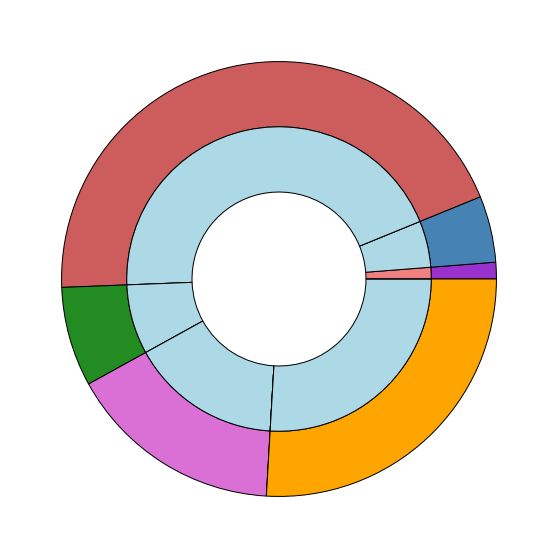

In [73]:
diff_std_OC_He_AM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_AM_G1, subject_grad_F=array_aligned_fc_OC_G1, sample_modality='OC_HeAM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


### OC vs He (PM)

Number of parcels for which there males have a statistically significant larger variance than females: 181
Number of parcels for which there females have a statistically significant larger variance than males: 2
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 137
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.56; Females = 1.02
Maximum SD: Males = 7.412; Females = 5.888


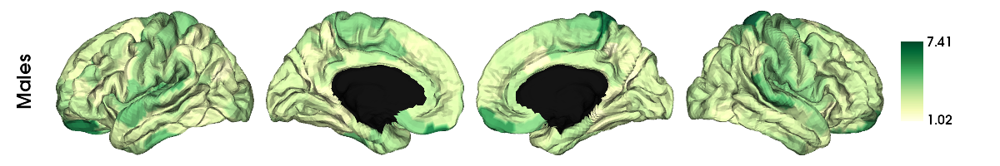

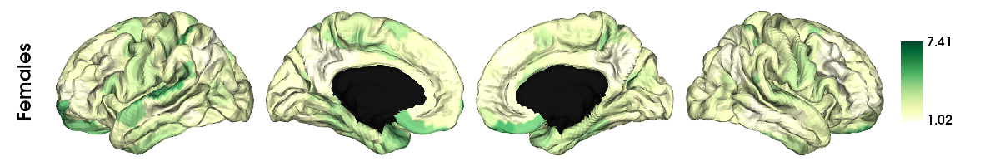

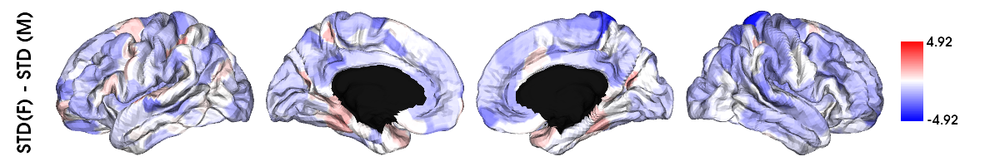

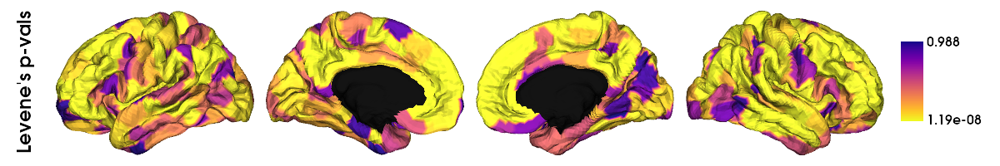

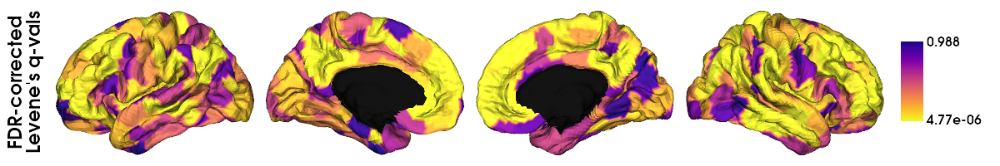

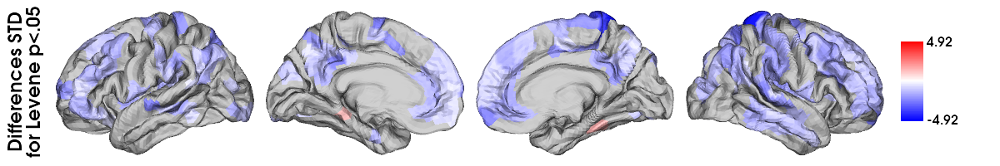

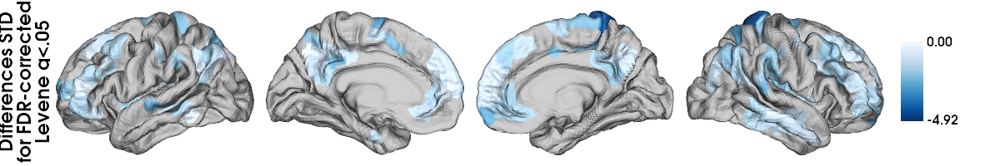

Number of significant parcels: 137

Number of significant parcels for males: 137
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):
- visual: 1 out of 61 (1.64%) -> 0.73% of overall significance
- sensory motor: 30 out of 77 (38.96%) -> 21.9% of overall significance
- DMN: 51 out of 46 (110.87%) -> 37.23% of overall significance
- dorsal attention: 8 out of 47 (17.02%) -> 5.84% of overall significance
- ventral attention: 19 out of 26 (73.08%) -> 13.87% of overall significance
- limbic: 2 out of 53 (3.77%) -> 1.46% of overall significance
- fronto parietal: 26 out of 90 (28.89%) -> 18.98% of overall significance





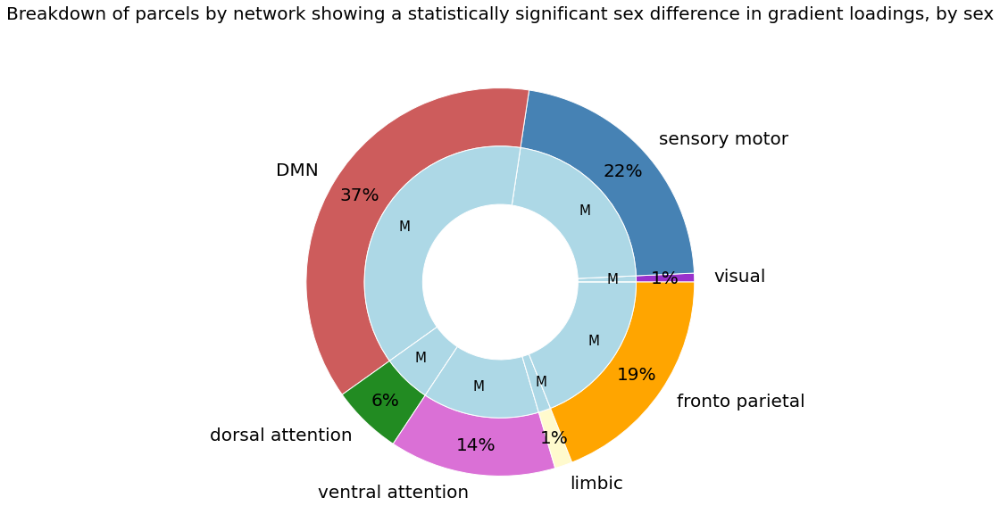

Number of significant parcels by sex:
visual - Male: 1, Female: 0
sensory motor - Male: 30, Female: 0
DMN - Male: 51, Female: 0
dorsal attention - Male: 8, Female: 0
ventral attention - Male: 19, Female: 0
limbic - Male: 2, Female: 0
fronto parietal - Male: 26, Female: 0





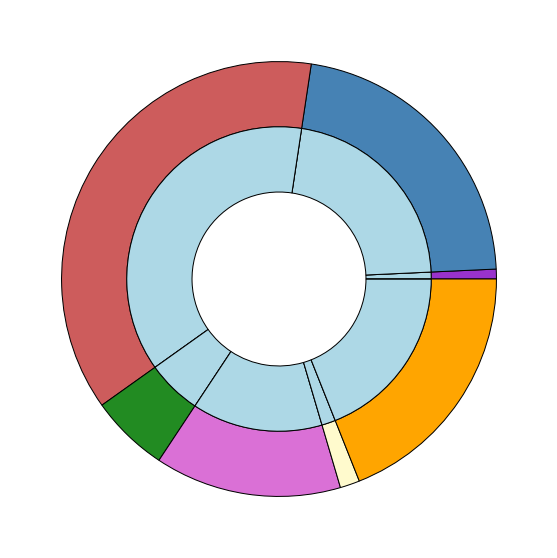

In [74]:
diff_std_OC_He_PM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_PM_G1, subject_grad_F=array_aligned_fc_OC_G1, sample_modality='OC_HePM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


## MixedLM (OC)

### Run model

In [83]:
lmer_res_OC = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_OC_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28OC.z_estradiol, 'progesterone': hormones_28OC.z_progesterone}),  # fixed effects (covariate)
        groups = hormones_28OC.Experiment, 
        exog_re = None,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_OC['parcel'].append(i)
    lmer_res_OC['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_OC['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_OC['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res_OC['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res_OC['estradiol_q_val'] = fdrcorrection(lmer_res_OC['estradiol_p_val'], alpha=0.05)[1]
lmer_res_OC['progesterone_q_val'] = fdrcorrection(lmer_res_OC['progesterone_p_val'], alpha=0.05)[1]

lmer_res_OC = pd.DataFrame(lmer_res_OC)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimi

In [84]:
lmer_res_OC

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,-0.927736,0.353544,-2.264548,0.023540,0.979126,0.184631
1,1,0.453320,0.650318,-1.694151,0.090237,0.993052,0.360946
2,2,-1.447667,0.147710,-0.888499,0.374272,0.923189,0.675312
3,3,-1.809239,0.070414,-3.899717,0.000096,0.831487,0.019261
4,4,-1.479521,0.139001,0.201522,0.840290,0.911572,0.954875
...,...,...,...,...,...,...,...
395,395,-0.582108,0.560494,-0.559132,0.576071,0.979126,0.820031
396,396,0.478821,0.632066,-0.124548,0.900881,0.993052,0.962847
397,397,-0.404364,0.685945,-0.752075,0.452006,0.993052,0.720328
398,398,-1.469374,0.141731,0.094232,0.924925,0.911572,0.962847


In [85]:
np.where(np.array(lmer_res_OC.estradiol_q_val) < 0.05)[0].shape

(0,)

In [87]:
np.where(np.array(lmer_res_OC.progesterone_q_val) < 0.05)[0].shape

(3,)

In [89]:
np.isnan(lmer_res_OC.estradiol_q_val).any()

False

In [90]:
np.isnan(lmer_res_OC.progesterone_q_val).any()

False

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [91]:
estradiol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.estradiol_t_val, seven_networks=False)
progesterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.progesterone_t_val, seven_networks=False)
estradiol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.estradiol_q_val, seven_networks=False)
progesterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_OC.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [92]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_fs5 = []

for i in range(len(estradiol_q_val_fs5)):
    if estradiol_q_val_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_fs5.append(estradiol_t_val_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_fs5 = np.array(estradiol_fdr_corrected_tvals_fs5)



# progesterone

progesterone_fdr_corrected_tvals_fs5 = []

for i in range(len(progesterone_q_val_fs5)):
    if progesterone_q_val_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_fs5.append(progesterone_t_val_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_fs5 = np.array(progesterone_fdr_corrected_tvals_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


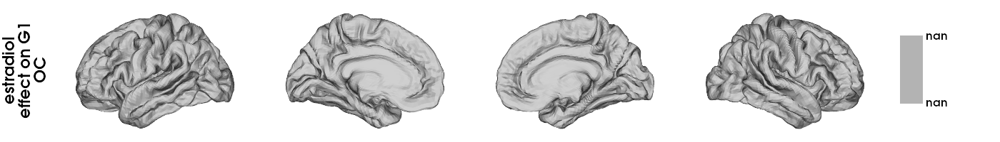

In [93]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1\nOC"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'OC_estr_on_G1.png')

plotted_hemispheres

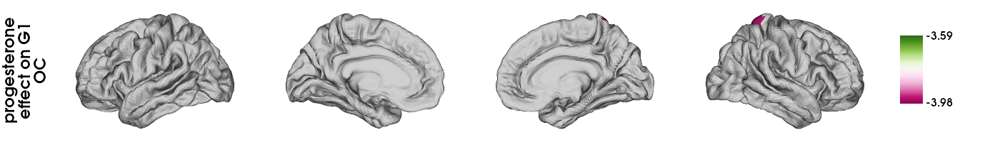

In [94]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1\nOC"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'OC_prog_on_G1.png')

plotted_hemispheres

## Correlation estradiol effects Me and OC -> VERY STRANGE THAT DATASETS YIELD SUCH DIFFERENT EFFECTS - may suggest a estr*prog interaction

In [95]:
stats.spearmanr(lmer_res_excl26.estradiol_t_val, lmer_res_OC.estradiol_t_val)

SpearmanrResult(correlation=-0.0023171394821217633, pvalue=0.9631525786312658)

In [96]:
stats.spearmanr(lmer_res_excl26.progesterone_t_val, lmer_res_OC.progesterone_t_val)

SpearmanrResult(correlation=0.0130009562559766, pvalue=0.7954683161911708)

## Dispersion Analyses (OC) - hormonal effects

### Within-network integration/dispersion analysis

Within network dispersion is calculated as the sum squared of the Euclidean distances from each network node to the network centroid, and higher values represent a wider distribution of the network in the 1D gradient space, ie: a more dispersed network (=less integrated).

-> computed at the daily level

#### Computing within dispersion metric

In [131]:
# compute for each experimental day and for each yeo network a) network centroid position; b) within network dispersion metric (higher value = wider distribution = more dispersion)

yeo_cog = []  # center of gravity (median) for given network (i.e., network centroid position) (7 x 29)
WN_dispersion = []  # Within network dispersion: sum squared Euclidean distance of network nodes to the network centroid at experimental day level (7 x 29)


# gradient values
g1 = array_aligned_fc_OC_G1.T  # transpose to obtain shape (400 x 30) in order to access/index the relevant network nodes


# iterate over the 7 Yeo networks
for n in range(7):
    
    # identify the nodes of given Yeo network
    netNodes = np.where(yeo_17_2_7 == (n + 1))
    netNodes = np.squeeze(netNodes)
    
    # get the gradient loadings of the nodes of the given Yeo network, for each experimental day (shape: number of nodes in network x N)
    G1_net = g1[netNodes]
    
    
    ### identify the centroid / center of gravity (= median) of the given Yeo network for each experimental day (shape: N)
    yeo_cog_net = np.median(G1_net, axis=0)  
    yeo_cog.append(yeo_cog_net)
    
    
    ### within network dispersion: 1 within network dispersion value per experimental day (per network)
    
    # compute (per subject) the Eucledian distance between each gradient loading (in Yeo network) and that network's centroid
    dist_nodes_to_cog = G1_net - yeo_cog_net  # shape: number of nodes in network x N
    
    # take the sum of squares of this Eucledian distance 
    sum_of_squares = np.sum((dist_nodes_to_cog**2), axis = 0)  # shape: N
    
    # append to list
    WN_dispersion.append(sum_of_squares)
    
    
yeo_cog = np.array(yeo_cog)
WN_dispersion = np.array(WN_dispersion)

In [132]:
WN_dispersion.shape

(7, 30)

#### Hormonal effects in within-network dispersion (linear mixed effects model)

using statsmodels package

from formula: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLM.from_formula.html

accessing results: https://www.statsmodels.org/dev/generated/statsmodels.regression.mixed_linear_model.MixedLMResults.html

In [133]:
lmer_WN_dispersion_OC_hormonal_contrast_res = {'yeo_network' : ["visual", "sensory motor", "dorsal attention", "ventral attention", "limbic", "fronto parietal", "DMN"], 
                                 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}


# iterate over the 7 yeo netwokrs
for i in range(7):
    
    # define model
    model = sm.MixedLM(
        endog = WN_dispersion[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28OC.estradiol, 'progesterone': hormones_28OC.progesterone}),  # fixed effects (covariate)
        groups = hormones_28OC.Experiment, 
        exog_re = hormones_28OC.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


lmer_WN_dispersion_OC_hormonal_contrast_res = pd.DataFrame(lmer_WN_dispersion_OC_hormonal_contrast_res)
lmer_WN_dispersion_OC_hormonal_contrast_res = lmer_WN_dispersion_OC_hormonal_contrast_res.set_index('yeo_network')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [134]:
lmer_WN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
yeo_network,,,,
visual,-2.748107,0.005994,4.142555,3.434585e-05
sensory motor,0.640421,0.521899,11.337497,8.555695e-30
dorsal attention,-3.278579,0.001043,9.176762,4.442496e-20
ventral attention,-0.024444,0.980498,7.651441,1.987399e-14
limbic,-2.373505,0.017620,6.084160,1.171033e-09
fronto parietal,-1.790223,0.073418,3.787232,1.523346e-04
DMN,-0.025774,0.979437,4.237238,2.262863e-05


### Between-network integration/dispersion analysis

Between network dispersion is the Euclidean distance between two network centroids, and higher values reflect greater distance (more dispersion / less integration) -> computed at the experimental day level

In [135]:
# compute the between network dispersion metric (Eucledian distance) only once for each pariwise network comparison, whilst keeping track what networks are being compared

BN_dispersion_OC_hormonal_contrast_res = {'pairwise_comparison' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

# iterate over 7 Yeo networks
for n1 in range(7):
    
    for n2 in range(7):
        
        current_pairwise_comparison = [n1+1, n2+1]
        
        
        if n1!=n2 and [n1+1, n2+1] not in BN_dispersion_OC_hormonal_contrast_res['pairwise_comparison'] and list(reversed([n1+1, n2+1])) not in BN_dispersion_OC_hormonal_contrast_res['pairwise_comparison']:
            
            # append the pairwise comparison to dict
            BN_dispersion_OC_hormonal_contrast_res['pairwise_comparison'].append(current_pairwise_comparison)
        
            # compute the distance between centroid of network 1 and centroid of network 2 and append it to dict (=BN_dispersion)
            BN_dispersion = yeo_cog[n1] - yeo_cog[n2]
            
            
            ### compute linear model for current pairwise between network dispersion (distance between centroids)
            
            # define model
            model = sm.MixedLM(
                endog = BN_dispersion,  # dependent variable
                exog = pd.DataFrame({'estradiol': hormones_28OC.estradiol, 'progesterone': hormones_28OC.progesterone}),  # fixed effects (covariate)
                groups = hormones_28OC.Experiment, 
                exog_re = hormones_28OC.ExperimentDay,  # covariates random effects
                exog_vc=None)

    
            # fit model
            results = model.fit()
            #results.summary()

            # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
            BN_dispersion_OC_hormonal_contrast_res['estradiol_t_val'].append(results.tvalues['estradiol'])
            BN_dispersion_OC_hormonal_contrast_res['estradiol_p_val'].append(results.pvalues['estradiol'])
            BN_dispersion_OC_hormonal_contrast_res['progesterone_t_val'].append(results.tvalues['progesterone'])
            BN_dispersion_OC_hormonal_contrast_res['progesterone_p_val'].append(results.pvalues['progesterone']) 


BN_dispersion_OC_hormonal_contrast_res = pd.DataFrame(BN_dispersion_OC_hormonal_contrast_res)
BN_dispersion_OC_hormonal_contrast_res = BN_dispersion_OC_hormonal_contrast_res.set_index('pairwise_comparison')

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [136]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_comparison_names = []

for label in BN_dispersion_OC_hormonal_contrast_res.index:
    
    n1 = None
    n2 = None
    
    if label[0] == 1:
        n1 = 'visual'
    elif label[0] == 2:
        n1 = 'sensory motor'
    elif label[0] == 3:
        n1 = 'dorsal attention'
    elif label[0] == 4:
        n1 = 'ventral attention'
    elif label[0] == 5:
        n1 = 'limbic'
    elif label[0] == 6:
        n1 = 'fronto parietal'
    elif label[0] == 7:
        n1 = 'DMN'
        
    if label[1] == 1:
        n2 = 'visual'
    elif label[1] == 2:
        n2 = 'sensory motor'
    elif label[1] == 3:
        n2 = 'dorsal attention'
    elif label[1] == 4:
        n2 = 'ventral attention'
    elif label[1] == 5:
        n2 = 'limbic'
    elif label[1] == 6:
        n2 = 'fronto parietal'
    elif label[1] == 7:
        n2 = 'DMN'
        
    new_comparison_names.append(n1+' - '+n2)    
    
    
    
# make new comparison names the index of the results dataframe
BN_dispersion_OC_hormonal_contrast_res['new_comparison_names'] = new_comparison_names
BN_dispersion_OC_hormonal_contrast_res = BN_dispersion_OC_hormonal_contrast_res.set_index('new_comparison_names')
BN_dispersion_OC_hormonal_contrast_res.index.name = 'pairwise_comparisons'

In [137]:
BN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val
pairwise_comparisons,,,,
visual - sensory motor,2.073855,3.809279e-02,-9.436836,3.842055e-21
visual - dorsal attention,-2.520359,1.172351e-02,6.295583,3.062459e-10
visual - ventral attention,1.454238,1.458804e-01,-7.571163,3.698990e-14
visual - limbic,-3.490600,4.819369e-04,6.070900,1.271955e-09
visual - fronto parietal,-3.791272,1.498775e-04,9.301141,1.389465e-20
visual - DMN,-4.041703,5.306447e-05,10.552604,4.940837e-26
sensory motor - dorsal attention,-3.873690,1.071996e-04,13.950689,3.115798e-44
sensory motor - ventral attention,-3.256537,1.127800e-03,12.846615,8.985701e-38
sensory motor - limbic,-3.990914,6.581912e-05,12.114455,8.855121e-34


### Null model analysis - spin permutation

For each model, we computed a null distribution of age-related differences using 1000 spherical rotations of the original parcellation scheme, thereby ensuring that for each permutation of the null distribution the spatial autocorrelation was retained (Alexander-Bloch et al., 2018; Vasa, 2017). 

#### Compute the null distributions of t-values for the hormone contrasts in the within and between dispersion analyses

Computed by p28Me_spin_permutation_lmer_within_between_network_dispersion_OC.py

#### Load null distributions of t-values

In [138]:
WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_estradiol_contrast_null_distr_OC.csv')
WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'WN_dispersion_perm_tval_progesterone_contrast_null_distr_OC.csv')

BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_estradiol_contrast_null_distr_OC.csv')
BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr = pd.read_csv(resdir+'BN_dispersion_perm_tval_progesterone_contrast_null_distr_OC.csv')

#### Compute the spin p-values 

##### Within Network dispersion

Estradiol

In [139]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr[network], score = lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'estradiol_t_val'], kind='mean')/100
    
    
    # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
    if percentile_of_tval == 0 or percentile_of_tval == 1:
        spin_p_val.append(0.0001)
        sig_post_bonferroni.append('sig')
        
    
    else:
        
        # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
        # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
        if lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'estradiol_t_val'] < np.median(WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr[network]):
            spin_p_val.append(round(percentile_of_tval, 3))

            # given that we make 7 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/7 = 0.0036)
            if percentile_of_tval < 0.025/7:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')



        # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
        else:
            spin_p_val.append(round(1 - percentile_of_tval, 3))

            # given that we make 7 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/7 = 0.0036)
            if (1 - percentile_of_tval) < 0.025/7:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
lmer_WN_dispersion_OC_hormonal_contrast_res['estradiol Bonferroni sig. (alpha = 0.004)'] = sig_post_bonferroni

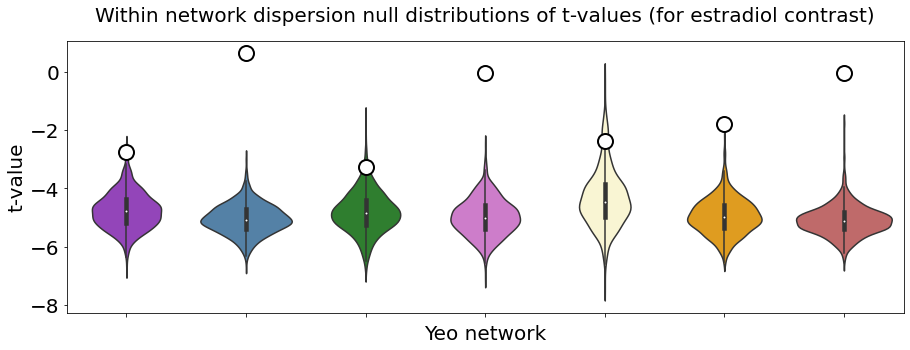

In [140]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr = pd.melt(WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr, 
                                                               value_vars = WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


sns.violinplot(data = WN_dispersion_OC_perm_tval_estradiol_contrast_null_distr,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False)

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_OC_hormonal_contrast_res.estradiol_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for estradiol contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels('', rotation=40, ha="right") 
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # to show tick labels

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_OC_null_distr_tvals_estradiol.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

Progesterone

In [141]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across networks in order to compare the t-value for a given network to that network's null distribution of tvalues
for network in lmer_WN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr[network], score = lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'progesterone_t_val'], kind='mean')/100
    
    
    # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
    if percentile_of_tval == 0 or percentile_of_tval == 1:
        spin_p_val.append(0.0001)
        sig_post_bonferroni.append('sig')
        
    
    else:
        
        # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
        # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
        if lmer_WN_dispersion_OC_hormonal_contrast_res.loc[network, 'progesterone_t_val'] < np.median(WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr[network]):
            spin_p_val.append(round(percentile_of_tval, 3))

            # given that we make 7 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/7 = 0.0036)
            if percentile_of_tval < 0.025/7:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')



        # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
        else:
            spin_p_val.append(round(1 - percentile_of_tval, 3))

            # given that we make 7 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/7 = 0.0036)
            if (1 - percentile_of_tval) < 0.025/7:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
lmer_WN_dispersion_OC_hormonal_contrast_res['progesterone Bonferroni sig. (alpha = 0.004)'] = sig_post_bonferroni

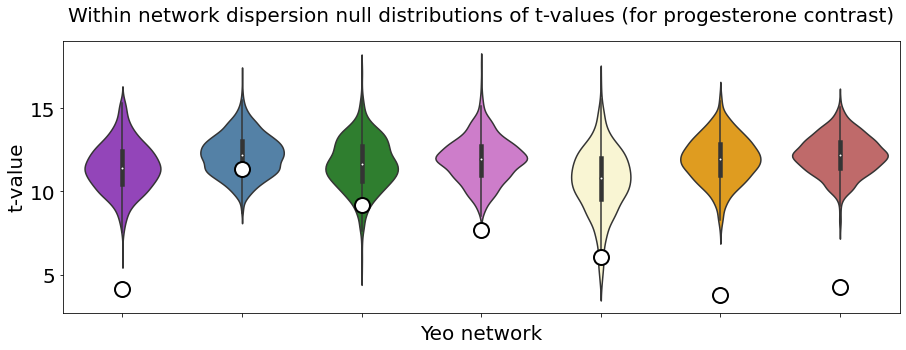

In [142]:
### Violin plot of t-values (null distributions) by Yeo network - in order to show where the empirical t-value is located

WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr = pd.melt(WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr, 
                                                               value_vars = WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr.columns.tolist(), 
                                                               var_name = 'yeo_network', value_name='t_vals', ignore_index=False)

fig, ax = plt.subplots(figsize=(15, 5))


sns.violinplot(data = WN_dispersion_OC_perm_tval_progesterone_contrast_null_distr,
                    x="yeo_network",
                    y="t_vals",
                    #hue="",
                    palette = palette_labeled_networks,
                    split = False)

# add the empirical t-values on the respective network violins
sns.stripplot(x=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], 
              y=lmer_WN_dispersion_OC_hormonal_contrast_res.progesterone_t_val, color='white', edgecolor='black', size =15, linewidth=2, jitter=False)

ax.axes.set_title("Within network dispersion null distributions of t-values (for progesterone contrast)", y=1.05, fontsize=20)
ax.set_xlabel("Yeo network",fontsize=20)
ax.set_ylabel("t-value",fontsize=20)
ax.tick_params(labelsize=20)
ax.set_xticklabels('', rotation=40, ha="right") 
#ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")  # to show tick labels

#plt.show()

# save figure in directory 
plt.savefig(resdir_fig+'violin_WN_dispersion_OC_null_distr_tvals_progesterone.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when savingb

In [143]:
lmer_WN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol Bonferroni sig. (alpha = 0.004),progesterone_spin_p_val,progesterone Bonferroni sig. (alpha = 0.004)
yeo_network,,,,,,,,
visual,-2.748107,0.005994,4.142555,3.434585e-05,0.0030,sig,0.0001,sig
sensory motor,0.640421,0.521899,11.337497,8.555695e-30,0.0001,sig,0.2630,not sig
dorsal attention,-3.278579,0.001043,9.176762,4.442496e-20,0.0210,not sig,0.0510,not sig
ventral attention,-0.024444,0.980498,7.651441,1.987399e-14,0.0001,sig,0.0001,sig
limbic,-2.373505,0.017620,6.084160,1.171033e-09,0.0510,not sig,0.0250,not sig
fronto parietal,-1.790223,0.073418,3.787232,1.523346e-04,0.0001,sig,0.0001,sig
DMN,-0.025774,0.979437,4.237238,2.262863e-05,0.0001,sig,0.0001,sig


##### Between Network dispersion

In [144]:
# for better readability, rename the columns to the pairwise comparisons with Yeo network labels (instead of numbers)
new_col_names = []

for label in BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr.columns:
    
    n1 = None
    n2 = None
    
    if label[1] == '1':
        n1 = 'visual'
    elif label[1] == '2':
        n1 = 'sensory motor'
    elif label[1] == '3':
        n1 = 'dorsal attention'
    elif label[1] == '4':
        n1 = 'ventral attention'
    elif label[1] == '5':
        n1 = 'limbic'
    elif label[1] == '6':
        n1 = 'fronto parietal'
    elif label[1] == '7':
        n1 = 'DMN'
        
    if label[4] == '1':
        n2 = 'visual'
    elif label[4] == '2':
        n2 = 'sensory motor'
    elif label[4] == '3':
        n2 = 'dorsal attention'
    elif label[4] == '4':
        n2 = 'ventral attention'
    elif label[4] == '5':
        n2 = 'limbic'
    elif label[4] == '6':
        n2 = 'fronto parietal'
    elif label[4] == '7':
        n2 = 'DMN'
        
    new_col_names.append(n1+' - '+n2)    
    
    
BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr.columns = new_col_names
BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr.columns = new_col_names

Estradiol

In [145]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr[pairwise_comparison], score = BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'], kind='mean')/100
    
    # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
    if percentile_of_tval == 0 or percentile_of_tval == 1:
        spin_p_val.append(0.0001)
        sig_post_bonferroni.append('sig')
        
    
    else:
        
        # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
        # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
        if BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'estradiol_t_val'] < np.median(BN_dispersion_OC_perm_tval_estradiol_contrast_null_distr[pairwise_comparison]):
            spin_p_val.append(round(percentile_of_tval, 3))

            # given that we make 21 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/21 = 0.0012)
            if percentile_of_tval < 0.025/21:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')



        # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
        else:
            spin_p_val.append(round(1 - percentile_of_tval, 3))

            # given that we make 21 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/21 = 0.0012)
            if (1 - percentile_of_tval) < 0.025/21:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_OC_hormonal_contrast_res['estradiol_spin_p_val'] = spin_p_val
BN_dispersion_OC_hormonal_contrast_res['estradiol Bonferroni sig. (alpha = 0.001)'] = sig_post_bonferroni

Progesterone

In [146]:
# by computing the percentile rank of our empirical t-value relative to the null distribution of t-values obtained via spin permutation (stats.percentileofscore)

spin_p_val = []
sig_post_bonferroni = []


# iterate across pairwise comparisons in order to compare the t-value for a given pairwise comparison to that pairwise comparison's null distribution of tvalues
for pairwise_comparison in BN_dispersion_OC_hormonal_contrast_res.index:
    
    # compute the percentile of our empirical t-value
    percentile_of_tval = stats.percentileofscore(a = BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr[pairwise_comparison], score = BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'], kind='mean')/100
    
    
    # if round percentile of 0.0 or 1.0, it means that result is at the complete extremity of the null distribution, therefore result is pspin<0.001 -> assigning it 0.0001
    if percentile_of_tval == 0 or percentile_of_tval == 1:
        spin_p_val.append(0.0001)
        sig_post_bonferroni.append('sig')
        
    
    else:
        
        # two-tailed test therefore if our empirical t-value is negative, left tail therefore simply obtain the percentile rank of our t-value
        # left tail should be < 0 if normal distribution, but here we need to take median of null distribution (which is still close to zero) because distribution is not perfectly normal as it's been obtained from spin permutation of our data 
        if BN_dispersion_OC_hormonal_contrast_res.loc[pairwise_comparison, 'progesterone_t_val'] < np.median(BN_dispersion_OC_perm_tval_progesterone_contrast_null_distr[pairwise_comparison]):
            spin_p_val.append(round(percentile_of_tval, 3))

            # given that we make 21 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/21 = 0.0012)
            if percentile_of_tval < 0.025/21:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')



        # if  our empirical t-value is positive, right tail therefore take 1 - the percentile rank of our t-value
        else:
            spin_p_val.append(round(1 - percentile_of_tval, 3))

            # given that we make 21 comparisons, 2-tailed test, correct for multiple comparisons with bonferroni (new significance threshold: 0.025/21 = 0.0012)
            if (1 - percentile_of_tval) < 0.025/21:
                sig_post_bonferroni.append('sig')

            else:
                sig_post_bonferroni.append('not sig')
    
    

# add the spin permutation p-value and bonferroni corrected significance to results df
BN_dispersion_OC_hormonal_contrast_res['progesterone_spin_p_val'] = spin_p_val
BN_dispersion_OC_hormonal_contrast_res['progesterone Bonferroni sig. (alpha = 0.001)'] = sig_post_bonferroni

In [147]:
BN_dispersion_OC_hormonal_contrast_res

,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_spin_p_val,estradiol Bonferroni sig. (alpha = 0.001),progesterone_spin_p_val,progesterone Bonferroni sig. (alpha = 0.001)
pairwise_comparisons,,,,,,,,
visual - sensory motor,2.073855,3.809279e-02,-9.436836,3.842055e-21,0.348,not sig,0.044,not sig
visual - dorsal attention,-2.520359,1.172351e-02,6.295583,3.062459e-10,0.246,not sig,0.197,not sig
visual - ventral attention,1.454238,1.458804e-01,-7.571163,3.698990e-14,0.369,not sig,0.120,not sig
visual - limbic,-3.490600,4.819369e-04,6.070900,1.271955e-09,0.149,not sig,0.246,not sig
visual - fronto parietal,-3.791272,1.498775e-04,9.301141,1.389465e-20,0.143,not sig,0.089,not sig
visual - DMN,-4.041703,5.306447e-05,10.552604,4.940837e-26,0.128,not sig,0.053,not sig
sensory motor - dorsal attention,-3.873690,1.071996e-04,13.950689,3.115798e-44,0.075,not sig,0.002,not sig
sensory motor - ventral attention,-3.256537,1.127800e-03,12.846615,8.985701e-38,0.094,not sig,0.006,not sig
sensory motor - limbic,-3.990914,6.581912e-05,12.114455,8.855121e-34,0.088,not sig,0.014,not sig


# Building gradients (Me) (without excluding day 26)

## Mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


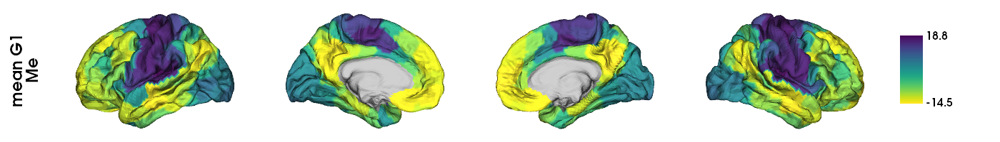

In [48]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix = sum(fc_matrices)/len(fc_matrices)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
mean_fc_grad = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad.fit(mean_fc_matrix)

# mean G1
mean_fc_G1 = mean_fc_grad.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nMe"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'Me_mean_G1.png')
    

plotted_hemispheres

## Aligned gradients

In [49]:
compute_aligned_grad = compute_aligned_gradients(fc_matrices, mean_fc_grad.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1 = compute_aligned_grad['array_aligned_G1']

## Visualize gradient on day 26 to observe that there is indeed a problem

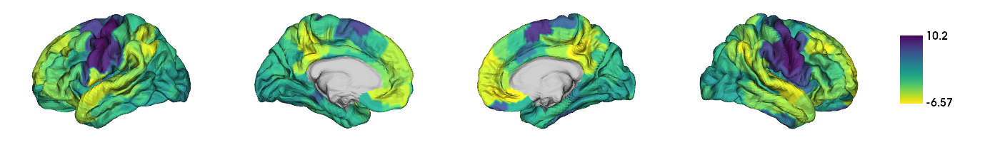

In [221]:
#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

aligned_fc_G1_D26_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_G1[25], seven_networks=False)

#### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])

plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = aligned_fc_G1_D26_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    #label_text = [""],
    zoom = 1.45)


## Variability in gradients

### Visualize daily gradients

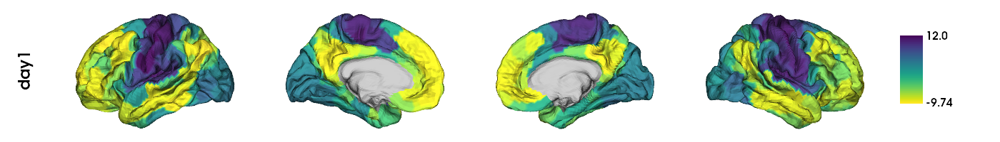

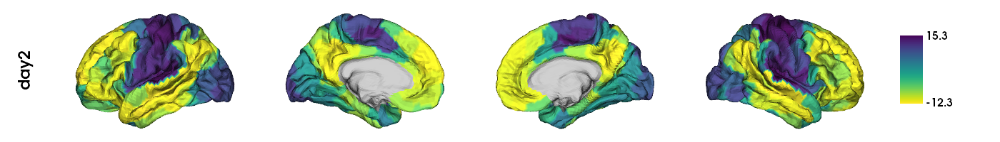

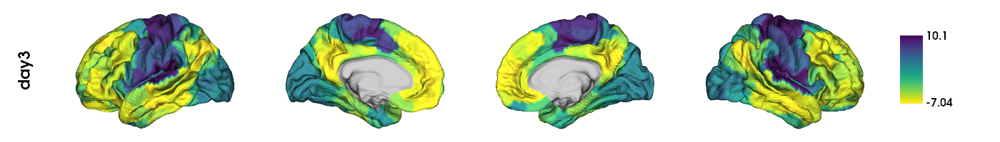

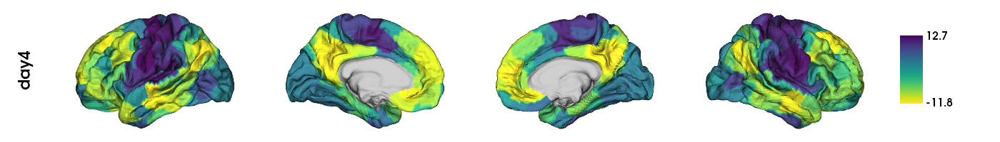

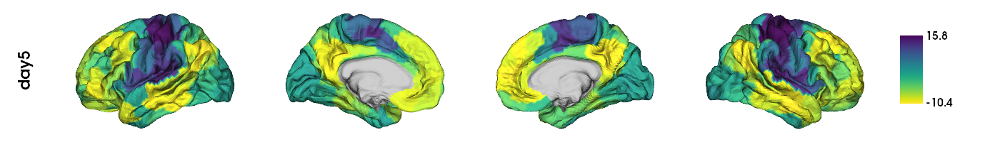

...

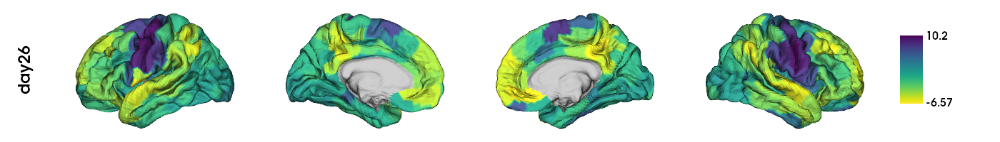

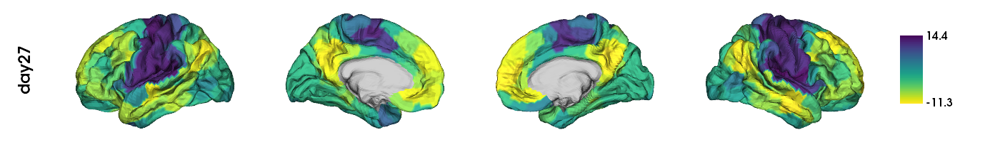

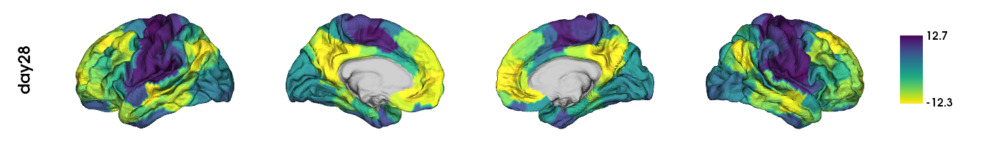

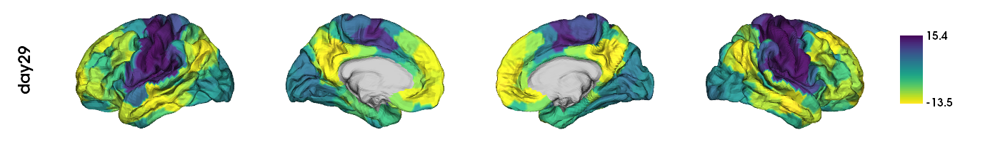

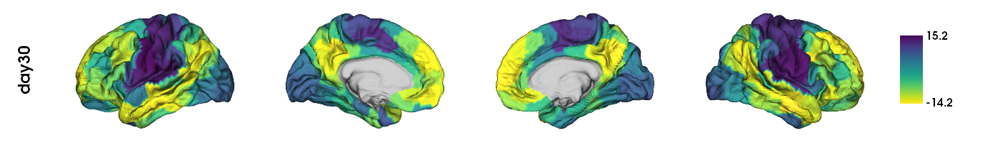

In [66]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_G1)):
    
    # transform to fs5 for plotting
    fc_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

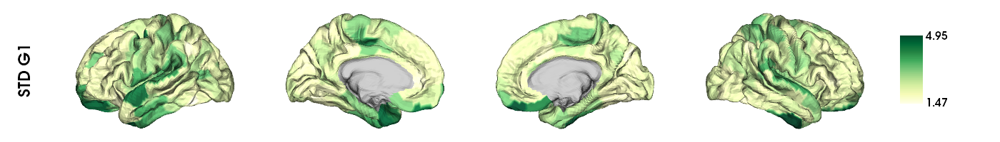

In [67]:
# compute the standard deviation across days per parcel
std_fc_G1 = np.std(array_aligned_fc_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1"],
    zoom = 1.45)

plotted_hemispheres

2023-09-27 17:02:33,132 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


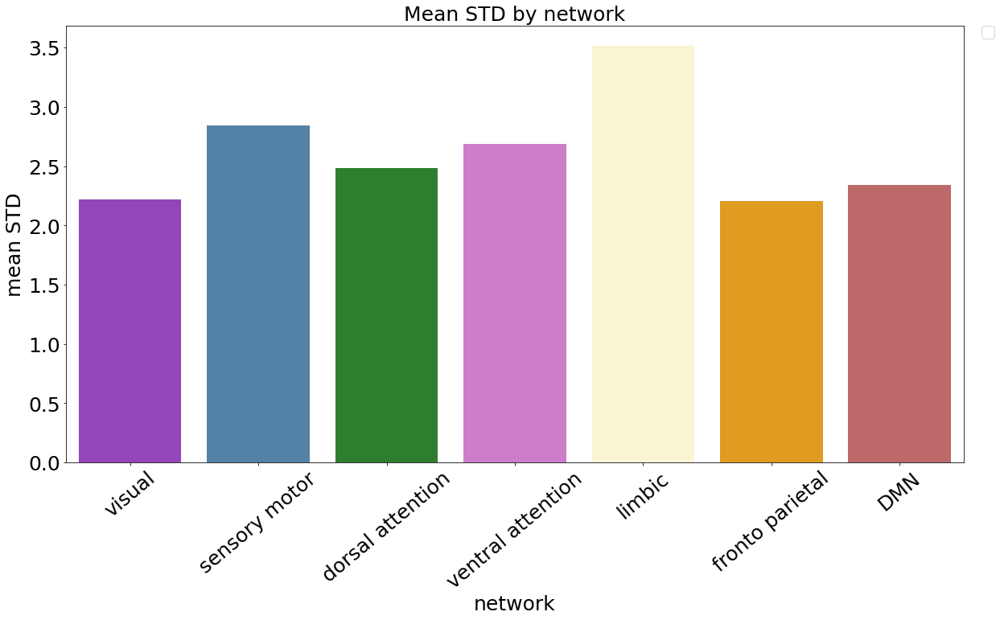

In [68]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


## MixedLM (Me) -> not excluding day 26

### Run model

In [133]:
lmer_res = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28Me.estradiol, 'progesterone': hormones_28Me.progesterone}),  # fixed effects (covariate)
        groups = hormones_28Me.Experiment, 
        exog_re = hormones_28Me.ExperimentDay,  # covariates random effects
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res['parcel'].append(i)
    lmer_res['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res['estradiol_q_val'] = fdrcorrection(lmer_res['estradiol_p_val'], alpha=0.05)[1]
lmer_res['progesterone_q_val'] = fdrcorrection(lmer_res['progesterone_p_val'], alpha=0.05)[1]

lmer_res = pd.DataFrame(lmer_res)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [134]:
results.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
          Mixed Linear Model Regression Results
==========================================================
Model:              MixedLM  Dependent Variable:  y       
No. Observations:   30       Method:              REML    
No. Groups:         1        Scale:               23.2552 
Min. group size:    30       Log-Likelihood:      -94.9715
Max. group size:    30       Converged:           No      
Mean group size:    30.0                                  
----------------------------------------------------------
                  Coef. Std.Err.   z   P>|z| [0.025 0.975]
----------------------------------------------------------
estradiol         0.023    0.016 1.428 0.153 -0.009  0.054
progesterone      0.151    0.146 1.032 0.302 -0.136  0.437
ExperimentDay Var 0.089    0.028                          
==========================================================

"""

In [135]:
lmer_res

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,3.440836,5.799207e-04,0.999936,0.317342,0.005797,0.414261
1,1,2.165823,3.032474e-02,0.923437,0.355779,0.073259,0.444040
2,2,1.710546,8.716492e-02,1.650808,0.098778,0.140589,0.163269
3,3,1.216016,2.239786e-01,1.464585,0.143034,0.289005,0.220052
4,4,0.539963,5.892228e-01,1.911426,0.055950,0.642205,0.114659
...,...,...,...,...,...,...,...
395,395,-4.440253,8.985319e-06,-1.335907,0.181580,0.000211,0.265080
396,396,-5.016835,5.252972e-07,0.732842,0.463655,0.000027,0.545476
397,397,-2.383863,1.713196e-02,-1.615871,0.106122,0.055264,0.173261
398,398,-2.176425,2.952349e-02,-1.553466,0.120312,0.073259,0.192499


In [136]:
np.where(np.array(lmer_res.estradiol_q_val) < 0.05)[0].shape

(105,)

In [137]:
np.where(np.array(lmer_res.progesterone_q_val) < 0.05)[0].shape

(57,)

In [138]:
np.isnan(lmer_res.estradiol_p_val).any()

False

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [139]:
estradiol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.estradiol_t_val, seven_networks=False)
progesterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.progesterone_t_val, seven_networks=False)
estradiol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.estradiol_q_val, seven_networks=False)
progesterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [140]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_fs5 = []

for i in range(len(estradiol_q_val_fs5)):
    if estradiol_q_val_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_fs5.append(estradiol_t_val_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_fs5 = np.array(estradiol_fdr_corrected_tvals_fs5)



# progesterone

progesterone_fdr_corrected_tvals_fs5 = []

for i in range(len(progesterone_q_val_fs5)):
    if progesterone_q_val_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_fs5.append(progesterone_t_val_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_fs5 = np.array(progesterone_fdr_corrected_tvals_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


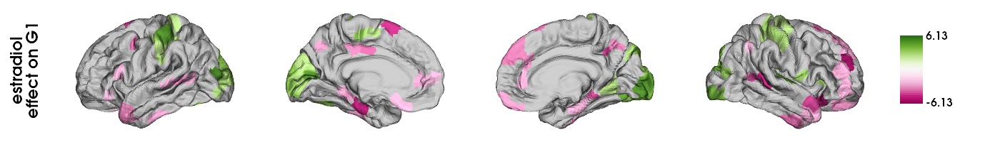

In [141]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

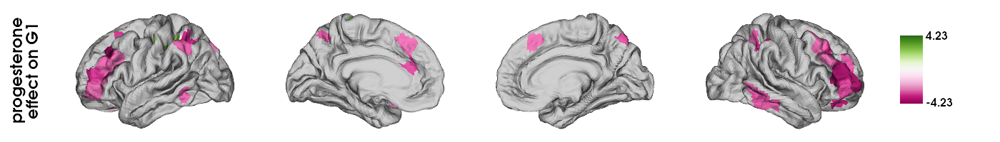

In [142]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

## MixedLM (Me & OC in same model -> but each aligned to own mean gradients) 

### Concatenate hormonal data and gradient arrays in order to run LMM

In [112]:
hormones_28MeOC_MCreindexed = pd.concat([hormones_28Me_excl26_MCreindexed, hormones_28OC_MCreindexed])

array_aligned_fc_G1_Meexcl26_OC_MCreindexed = np.concatenate((array_aligned_fc_G1_excl26_MCreindexed, array_aligned_fc_OC_G1_MCreindexed))

### Run model

In [137]:
lmer_res_Meexcl26_OC = {'parcel' : [], 'estradiol_t_val': [], 'estradiol_p_val': [], 'progesterone_t_val': [], 'progesterone_p_val': []}

for i in range(400):
    
    # define model   
    model = sm.MixedLM(
        endog = array_aligned_fc_G1_Meexcl26_OC_MCreindexed.T[i],  # dependent variable
        exog = pd.DataFrame({'estradiol': hormones_28MeOC_MCreindexed.estradiol, 'progesterone': hormones_28MeOC_MCreindexed.progesterone}),  # fixed effects (covariate)
        groups = hormones_28MeOC_MCreindexed.Experiment, 
        exog_re = hormones_28MeOC_MCreindexed['MC day'],  # covariates random effects -> INSTEAD OF Experimental Day
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_Meexcl26_OC['parcel'].append(i)
    lmer_res_Meexcl26_OC['estradiol_t_val'].append(results.tvalues['estradiol'])
    lmer_res_Meexcl26_OC['estradiol_p_val'].append(results.pvalues['estradiol'])
    lmer_res_Meexcl26_OC['progesterone_t_val'].append(results.tvalues['progesterone'])
    lmer_res_Meexcl26_OC['progesterone_p_val'].append(results.pvalues['progesterone']) 

lmer_res_Meexcl26_OC['estradiol_q_val'] = fdrcorrection(lmer_res_Meexcl26_OC['estradiol_p_val'], alpha=0.05)[1]
lmer_res_Meexcl26_OC['progesterone_q_val'] = fdrcorrection(lmer_res_Meexcl26_OC['progesterone_p_val'], alpha=0.05)[1]

lmer_res_Meexcl26_OC = pd.DataFrame(lmer_res_Meexcl26_OC)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random effects covariance is singular
  warnings.warn(msg)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2054: UserWarning: The random effects covariance matrix is singular.
  warnings.warn(_warn_cov_sing)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parame

In [138]:
results.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
         Mixed Linear Model Regression Results
=======================================================
Model:             MixedLM  Dependent Variable:  y     
No. Observations:  59       Method:              REML  
No. Groups:        2        Scale:               0.0035
Min. group size:   29       Log-Likelihood:      inf   
Max. group size:   30       Converged:           Yes   
Mean group size:   29.5                                
-------------------------------------------------------
             Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------
estradiol     0.000    0.000  1.855 0.064 -0.000  0.000
progesterone -0.005    0.003 -1.677 0.094 -0.010  0.001
MC day Var    0.000                                    
=======================================================

"""

In [139]:
lmer_res_Meexcl26_OC

,parcel,estradiol_t_val,estradiol_p_val,progesterone_t_val,progesterone_p_val,estradiol_q_val,progesterone_q_val
0,0,1.777680,0.075457,-0.453647,0.650083,0.101284,0.724326
1,1,3.938005,0.000082,0.479084,0.631879,0.003349,0.713987
2,2,1.485118,0.137513,-1.069738,0.284737,0.177436,0.565489
3,3,0.445708,0.655808,-0.108058,0.913950,0.686710,0.937385
4,4,0.330816,0.740783,-0.824331,0.409752,0.765667,0.601396
...,...,...,...,...,...,...,...
395,395,-3.204678,0.001352,1.492689,0.135518,0.004623,0.517779
396,396,-0.635350,0.525200,2.440814,0.014654,0.580332,0.517779
397,397,-3.153851,0.001611,1.318368,0.187381,0.004920,0.520804
398,398,-3.688695,0.000225,1.698183,0.089473,0.003575,0.517779


Random effect: MC day

In [140]:
np.where(np.array(lmer_res_Meexcl26_OC.estradiol_q_val) < 0.05)[0].shape

(276,)

In [141]:
np.where(np.array(lmer_res_Meexcl26_OC.progesterone_q_val) < 0.05)[0].shape

(0,)

Random effect: ExperimentDay not sure why results switch

In [104]:
np.where(np.array(lmer_res_Meexcl26_OC.estradiol_q_val) < 0.05)[0].shape

(0,)

In [105]:
np.where(np.array(lmer_res_Meexcl26_OC.progesterone_q_val) < 0.05)[0].shape

(268,)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [143]:
estradiol_t_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.estradiol_t_val, seven_networks=False)
progesterone_t_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.progesterone_t_val, seven_networks=False)
estradiol_q_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.estradiol_q_val, seven_networks=False)
progesterone_q_val_Meexcl26_OC_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_Meexcl26_OC.progesterone_q_val, seven_networks=False)

#### t-values for q < 0.05

In [145]:
## find t-values

# estradiol

estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5 = []

for i in range(len(estradiol_q_val_Meexcl26_OC_fs5)):
    if estradiol_q_val_Meexcl26_OC_fs5[i] <= 0.05:
        estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5.append(estradiol_t_val_Meexcl26_OC_fs5[i])
    else:
        estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5.append(float('nan'))
        
estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5 = np.array(estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5)



# progesterone

progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5 = []

for i in range(len(progesterone_q_val_Meexcl26_OC_fs5)):
    if progesterone_q_val_Meexcl26_OC_fs5[i] <= 0.05:
        progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5.append(progesterone_t_val_Meexcl26_OC_fs5[i])
    else:
        progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5.append(float('nan'))
        
progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5 = np.array(progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5)

### Plot on hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


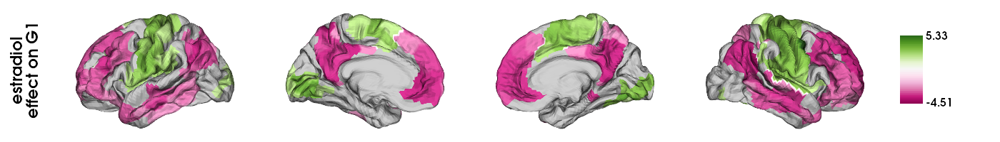

In [146]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = estradiol_fdr_corrected_tvals_Meexcl26_OC_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["estradiol\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


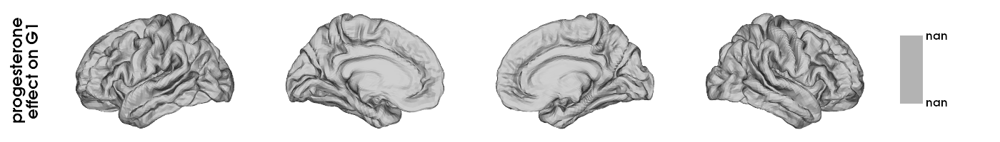

In [147]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = progesterone_fdr_corrected_tvals_Meexcl26_OC_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["progesterone\neffect on G1"],
    zoom = 1.45)

plotted_hemispheres

# He AM&PM -> effect time of the day

## Building gradients (He; AM & PM)

### Mean gradient

#### Reorder to have AM timepoints first, and PM timempoints second

In [121]:
hormones_28He_ordered = pd.concat([hormones_28He_AM, hormones_28He_PM], axis=0)

In [122]:
fc_matrices_He_ordered = np.concatenate((fc_matrices_He_AM, fc_matrices_He_PM), axis = 0)

In [123]:
fc_matrices_He_ordered.shape

(40, 400, 400)

#### Build mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


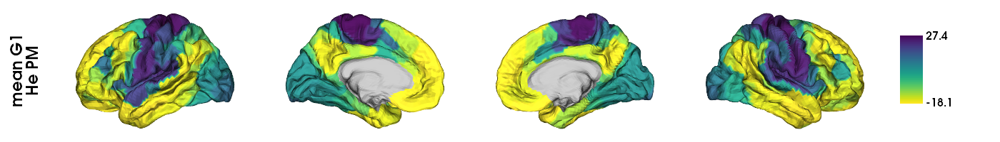

In [124]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_ordered = sum(fc_matrices_He_ordered)/len(fc_matrices_He_ordered)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_He = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_He = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_He.fit(mean_fc_matrix_He_ordered)

# mean G1
mean_fc_G1_He = mean_fc_grad_He.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range =,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_mean_G1.png')

plotted_hemispheres

### Aligned gradients

In [125]:
compute_aligned_grad_He = compute_aligned_gradients(fc_matrices_He_ordered, mean_fc_grad_He.gradients_) 

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_G1 = compute_aligned_grad_He['array_aligned_G1']

#### Export gradient to csv for R and dispersion analyses

## MixedLM (He AM&PM) -> taking saliva hormone levels to have full 40 data points

In [126]:
# add column to do the grouping by
hormones_28He_ordered['group'] = 1

# add column with numerical time of the day in order to include time of the day as fixed effect (model won't take str values)
hormones_28He_ordered['time_num'] = np.where(hormones_28He_ordered['time']== 'Morning', 0, 1)

In [143]:
lmer_res_He = {'parcel' : [], 'time_t_val' : [], 'time_p_val': [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'time': hormones_28He_ordered.time_num, 'testosterone': hormones_28He_ordered.z_total_testosterone_saliva, 'cortisol': hormones_28He_ordered.z_cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_ordered.group,  # the same across timepoints 
        exog_re = hormones_28He_ordered.day,  # covariates random effects: the day of sampling 
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results via indices
    lmer_res_He['parcel'].append(i)
    lmer_res_He['time_t_val'].append(results.tvalues['time'])
    lmer_res_He['time_p_val'].append(results.pvalues['time'])
    lmer_res_He['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He['cortisol_p_val'].append(results.pvalues['cortisol']) 
    
    
lmer_res_He['time_q_val'] = fdrcorrection(lmer_res_He['time_p_val'], alpha=0.05)[1]   
lmer_res_He['testosterone_q_val'] = fdrcorrection(lmer_res_He['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He['cortisol_q_val'] = fdrcorrection(lmer_res_He['cortisol_p_val'], alpha=0.05)[1]


lmer_res_He = pd.DataFrame(lmer_res_He)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimi

In [144]:
lmer_res_He

,parcel,time_t_val,time_p_val,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,time_q_val,testosterone_q_val,cortisol_q_val
0,0,-0.988722,0.322799,-0.141763,0.887267,-1.045679,0.295709,NaN,0.998909,0.722404
1,1,-1.251681,0.210686,-0.481503,0.630159,-0.084766,0.932447,NaN,0.998909,0.989065
2,2,0.230665,0.817575,-0.471417,0.637343,2.797253,0.005154,NaN,0.998909,0.137438
3,3,-0.571473,0.567679,-0.108588,0.913529,0.260013,0.794853,NaN,0.998909,0.944541
4,4,-0.196268,0.844400,-0.095358,0.924030,1.740614,0.081751,NaN,0.998909,0.545009
...,...,...,...,...,...,...,...,...,...,...
395,395,0.640643,0.521755,0.397742,0.690821,-0.293969,0.768782,NaN,0.998909,0.937538
396,396,0.040998,0.967298,0.494936,0.620645,-0.915549,0.359904,NaN,0.998909,0.780199
397,397,2.164888,0.030396,-1.266400,0.205370,-0.386052,0.699458,NaN,0.998909,0.920339
398,398,0.382891,0.701800,0.202063,0.839867,-0.526648,0.598438,NaN,0.998909,0.904519


In [145]:
np.where(np.array(lmer_res_He.time_q_val) < 0.05)[0].shape

(0,)

In [146]:
np.where(np.array(lmer_res_He.testosterone_q_val) < 0.05)[0].shape

(5,)

In [147]:
np.where(np.array(lmer_res_He.cortisol_q_val) < 0.05)[0].shape

(5,)

In [148]:
np.isnan(lmer_res_He.time_p_val).any()

True

In [149]:
np.isnan(lmer_res_He.testosterone_p_val).any()

False

In [150]:
np.isnan(lmer_res_He.cortisol_p_val).any()

False

In [151]:
np.argwhere(np.isnan(np.array(lmer_res_He['time_p_val'])))

array([[ 78],
       [314]])

In [152]:
np.argwhere(np.isnan(np.array(lmer_res_He['testosterone_p_val'])))

array([], shape=(0, 1), dtype=int64)

In [153]:
lmer_res_He = {'parcel' : [], 'time_t_val' : [], 'time_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'time': hormones_28He_ordered.time_num}),  # fixed effects (covariate)
        groups = hormones_28He_ordered.group,  # the same across timepoints
        exog_re = hormones_28He_ordered.day,  # covariates random effects: the day of sampling 
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_He['parcel'].append(i)
    lmer_res_He['time_t_val'].append(results.tvalues['time'])
    lmer_res_He['time_p_val'].append(results.pvalues['time'])
    
lmer_res_He['time_q_val'] = fdrcorrection(lmer_res_He['time_p_val'], alpha=0.05)[1]   

lmer_res_He = pd.DataFrame(lmer_res_He)

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/base/model.py:604: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2200: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:1634: UserWarning: Random ef

In [154]:
lmer_res_He

,parcel,time_t_val,time_p_val,time_q_val
0,0,-1.070564,0.284365,0.708379
1,1,-1.233687,0.217320,0.708379
2,2,0.533708,0.593544,0.830534
3,3,-0.549057,0.582966,0.830534
4,4,-0.278314,0.780771,0.902591
...,...,...,...,...
395,395,0.579637,0.562159,0.826705
396,396,-0.117428,0.906521,0.980022
397,397,1.339583,0.180381,0.708379
398,398,0.326814,0.743809,0.902591


In [155]:
np.where(np.array(lmer_res_He.time_q_val) < 0.05)[0].shape

(2,)

In [156]:
np.isnan(lmer_res_He.time_p_val).any()

False

# Correlations (inter- and intra-) individual differences in variability and hormonal effects

## Associations with INTER-individual differences

### Hormonal effects on female G1

#### Estradiol

In [111]:
stats.spearmanr(lmer_res_excl26.estradiol_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=0.1298940618378865, pvalue=0.009301253250183869)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.1445


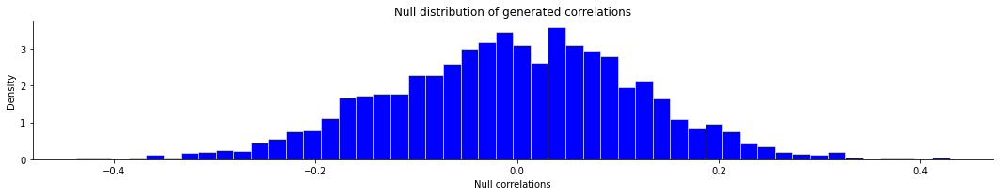

{'spin_test_p': 0.1445,
 'spin_test_d': array([ 0.07033256,  0.14097827, -0.15346235, ...,  0.1151333 ,
         0.06018663, -0.1627055 ])}

In [99]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.estradiol_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

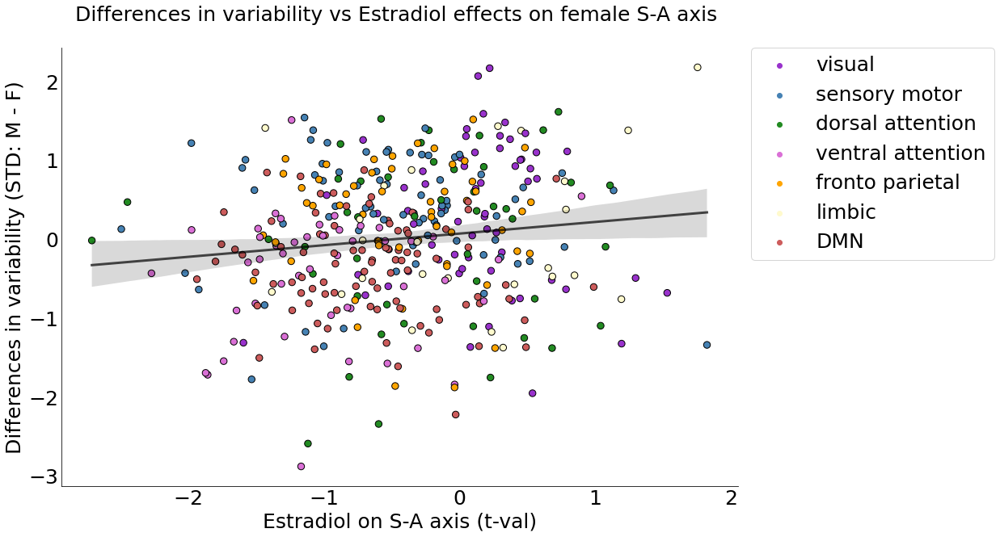

In [407]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Estradiol on S-A axis (t-val)': lmer_res_excl26.estradiol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Estradiol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Estradiol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Estradiol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Estradiol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_estr_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Progesterone

In [101]:
stats.spearmanr(lmer_res_excl26.progesterone_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=0.03853486584291151, pvalue=0.4421480743559699)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.3255


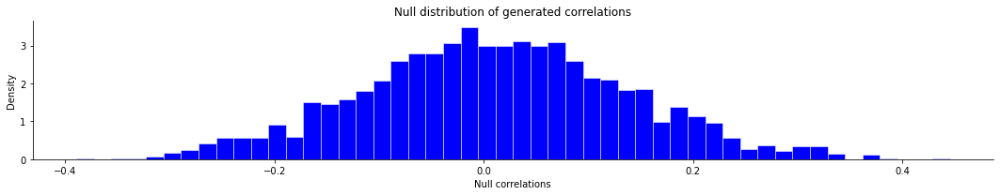

{'spin_test_p': 0.3255,
 'spin_test_d': array([-0.01672199, -0.02845452, -0.00041751, ...,  0.15070667,
         0.06035365,  0.00323584])}

In [102]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.progesterone_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

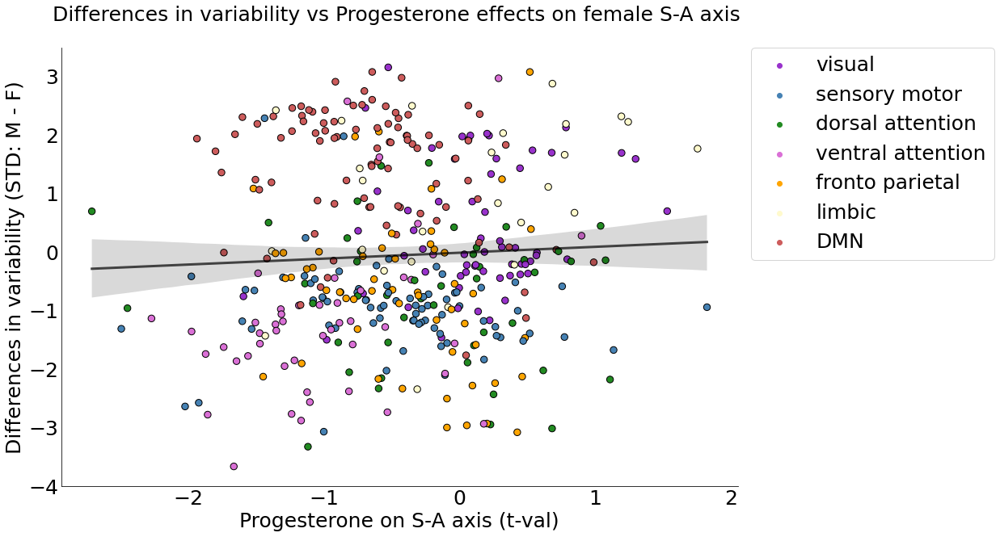

In [408]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Progesterone on S-A axis (t-val)': lmer_res_excl26.progesterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Progesterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Progesterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Progesterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Progesterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_prog_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

### Hormonal effects on male G1

#### Testosterone

In [114]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=-0.11393489959312245, pvalue=0.022667508477198627)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.291


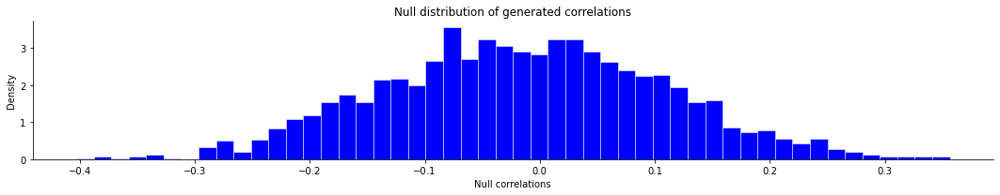

{'spin_test_p': 0.291,
 'spin_test_d': array([ 0.07028257,  0.03463393, -0.11717551, ...,  0.01613745,
        -0.02857978,  0.10482036])}

In [115]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.testosterone_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

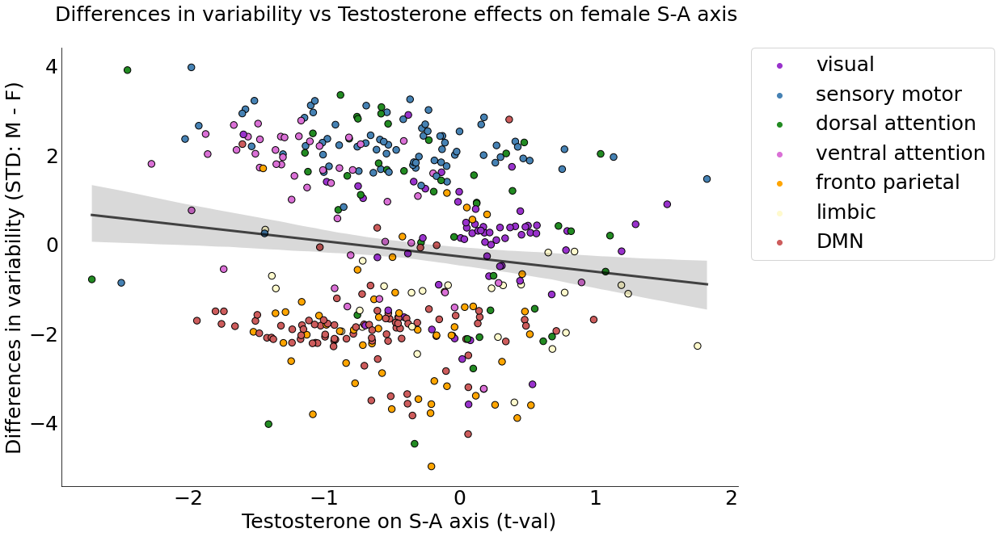

In [116]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Testosterone on S-A axis (t-val)': lmer_res_He_AM.testosterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Testosterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Testosterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Testosterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Testosterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_test_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Cortisol

In [117]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=-0.3244353402208764, pvalue=2.9488354678778704e-11)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0045000000000000005


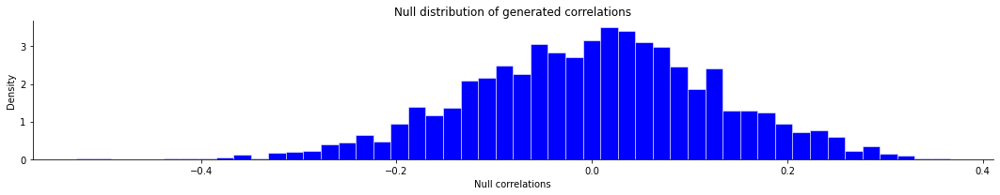

{'spin_test_p': 0.0045000000000000005,
 'spin_test_d': array([-0.10077034, -0.05375502,  0.02411223, ..., -0.00202501,
         0.08256613,  0.15922423])}

In [118]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.cortisol_t_val, y = diff_std_Me_He_AM, correlation_type = 'spearman')

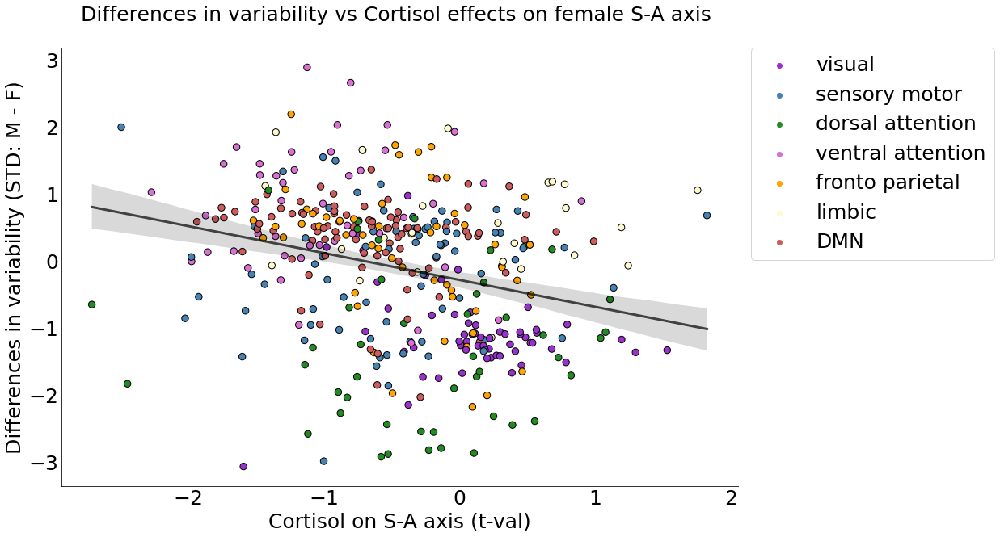

In [119]:
df = pd.DataFrame({'Differences in variability (STD: M - F)':  diff_std_Me_He_AM, 'Cortisol on S-A axis (t-val)': lmer_res_He_AM.cortisol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Differences in variability (STD: M - F)', y = 'Cortisol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Differences in variability (STD: M - F)', y = 'Cortisol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Cortisol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Cortisol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Differences in variability (STD: M - F)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
plt.savefig(resdir_fig+'scatter_diff_std_Me_He_AM_vs_cort_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

## Associations with INTRA-individual differences

In [112]:
Me_G1_excl26_std =  np.std(array_aligned_fc_G1_excl26, axis=0)
He_AM_G1_std = np.std(array_aligned_fc_He_AM_G1, axis=0)

### Hormonal effects on female G1

#### Estradiol

In [111]:
stats.spearmanr(lmer_res_excl26.estradiol_t_val, diff_std_Me_He_AM)

SpearmanrResult(correlation=0.1298940618378865, pvalue=0.009301253250183869)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.22


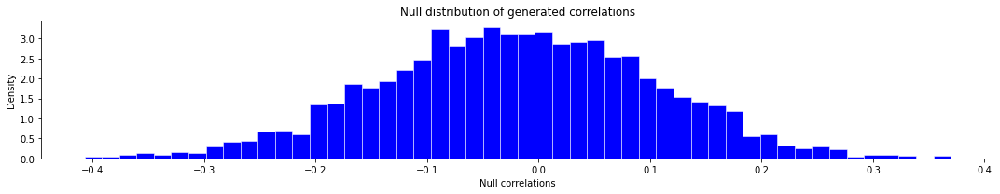

{'spin_test_p': 0.22,
 'spin_test_d': array([-0.16857686, -0.00277656, -0.12507046, ..., -0.14185508,
         0.04711801,  0.17116553])}

In [120]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.estradiol_t_val, y = Me_G1_excl26_std, correlation_type = 'spearman')

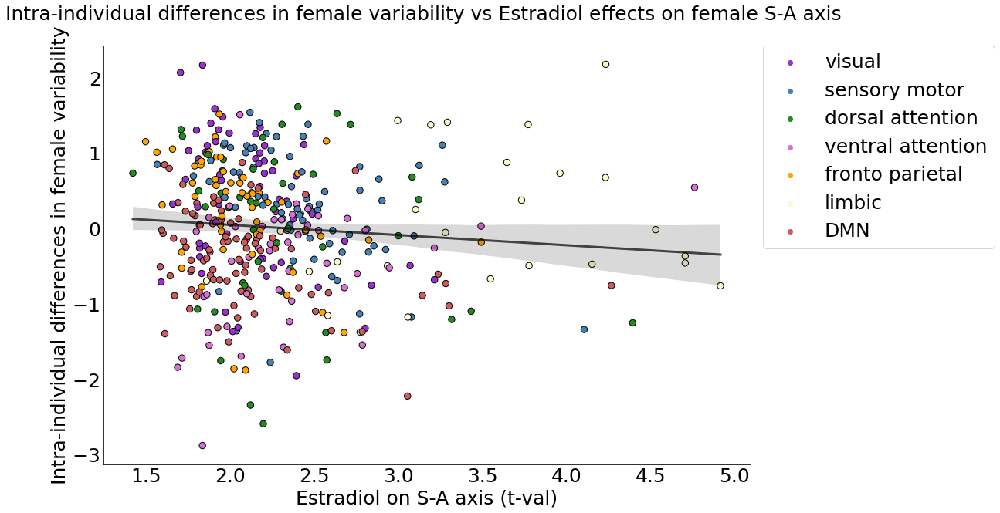

In [121]:
df = pd.DataFrame({'Intra-individual differences in female variability':  Me_G1_excl26_std, 'Estradiol on S-A axis (t-val)': lmer_res_excl26.estradiol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in female variability', y = 'Estradiol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in female variability', y = 'Estradiol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Intra-individual differences in female variability vs Estradiol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Estradiol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in female variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_Me_vs_estr_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Progesterone

In [122]:
stats.spearmanr(lmer_res_excl26.progesterone_t_val, Me_G1_excl26_std)

SpearmanrResult(correlation=-0.1730272064200401, pvalue=0.0005090149843001901)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.052500000000000005


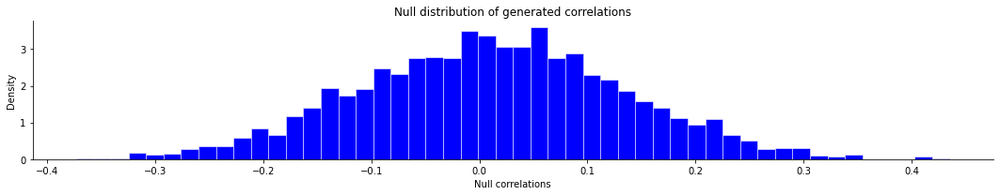

{'spin_test_p': 0.052500000000000005,
 'spin_test_d': array([-0.05951859,  0.04617656, -0.21095593, ..., -0.08786873,
        -0.04824534, -0.14995512])}

In [123]:
SpinPermutationTest_Schaefer400(x = lmer_res_excl26.progesterone_t_val, y = Me_G1_excl26_std, correlation_type = 'spearman')

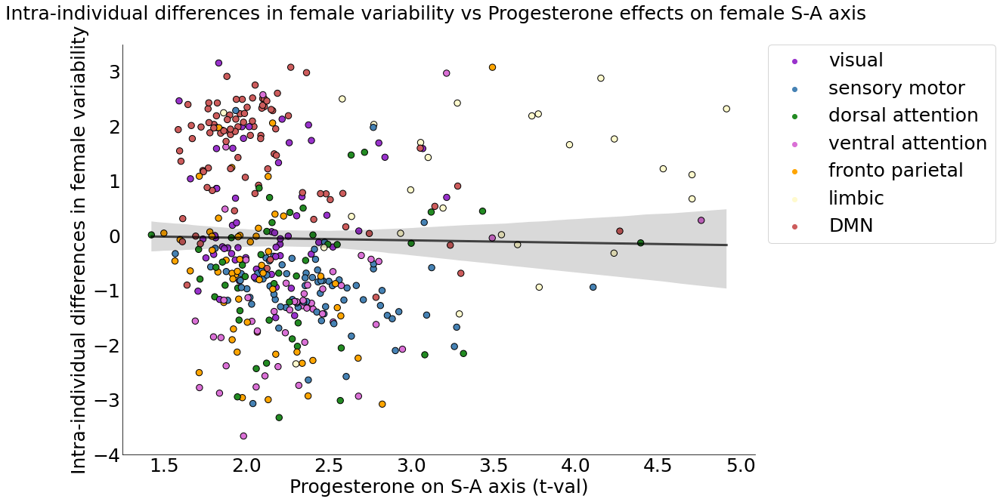

In [124]:
df = pd.DataFrame({'Intra-individual differences in female variability':  Me_G1_excl26_std, 'Progesterone on S-A axis (t-val)': lmer_res_excl26.progesterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in female variability', y = 'Progesterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in female variability', y = 'Progesterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Intra-individual differences in female variability vs Progesterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Progesterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in female variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_Me_vs_prog_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

### Hormonal effects on male G1

#### Testosterone

In [125]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, He_AM_G1_std)

SpearmanrResult(correlation=0.2578292989331183, pvalue=1.7032129877284123e-07)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.0645


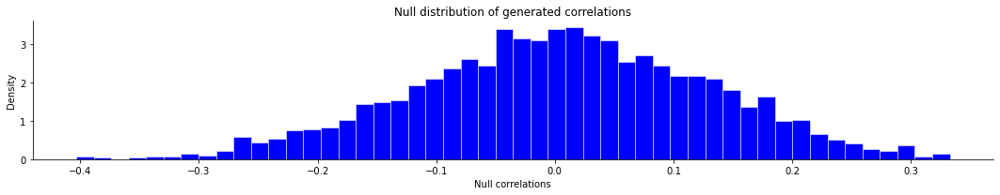

{'spin_test_p': 0.0645,
 'spin_test_d': array([ 0.04624121, -0.16465209,  0.17099852, ..., -0.08277489,
         0.01004154, -0.05233711])}

In [126]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.testosterone_t_val, y = He_AM_G1_std, correlation_type = 'spearman')

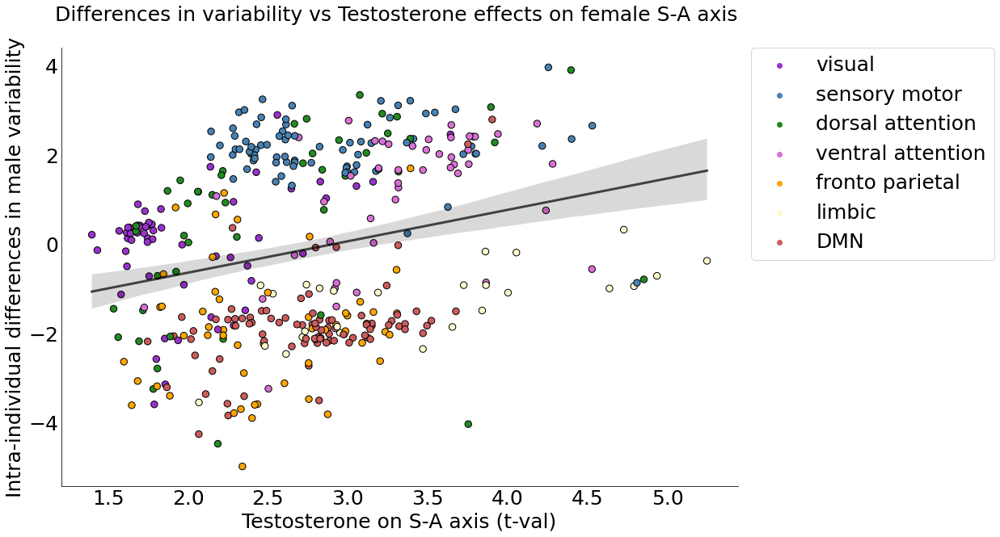

In [127]:
df = pd.DataFrame({'Intra-individual differences in male variability':  He_AM_G1_std, 'Testosterone on S-A axis (t-val)': lmer_res_He_AM.testosterone_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in male variability', y = 'Testosterone on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in male variability', y = 'Testosterone on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Testosterone effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Testosterone on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in male variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)

# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_He_AM_vs_test_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

#### Cortisol

In [129]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, He_AM_G1_std)

SpearmanrResult(correlation=0.4557714735717098, pvalue=6.530679100196468e-22)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.001


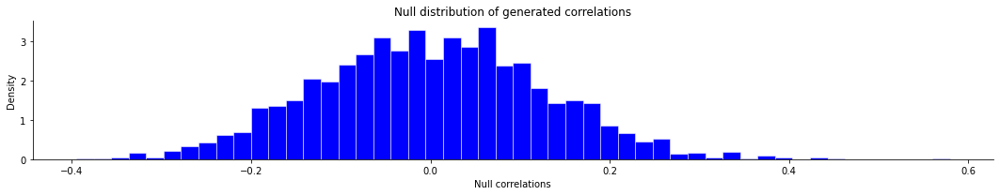

{'spin_test_p': 0.001,
 'spin_test_d': array([ 0.10502912,  0.03133546,  0.02469677, ...,  0.09743012,
        -0.07341997, -0.20314816])}

In [130]:
SpinPermutationTest_Schaefer400(x = lmer_res_He_AM.cortisol_t_val, y = He_AM_G1_std, correlation_type = 'spearman')

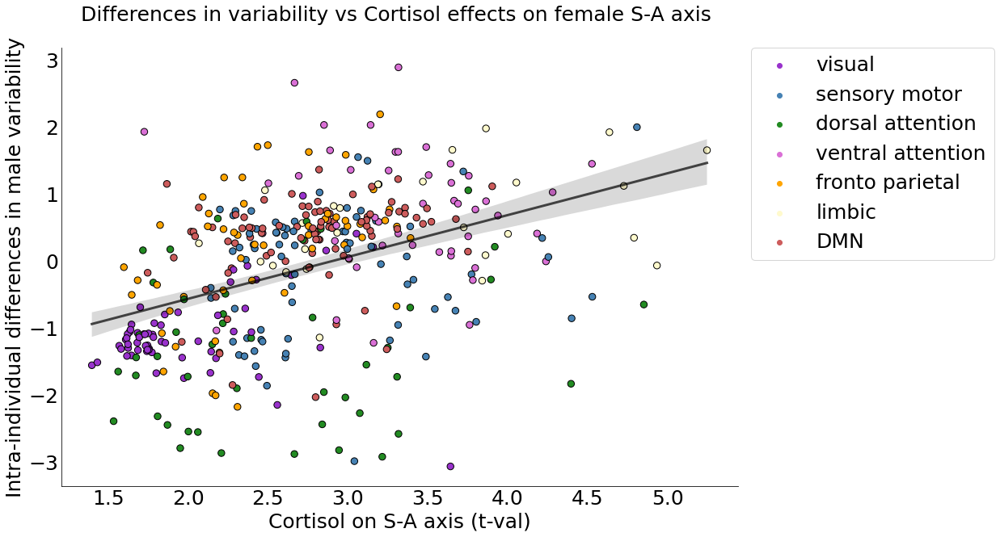

In [128]:
df = pd.DataFrame({'Intra-individual differences in male variability':  He_AM_G1_std, 'Cortisol on S-A axis (t-val)': lmer_res_He_AM.cortisol_t_val, 'yeo_17_2_7_networks_array_labels' : yeo_17_2_7_networks_array_labels})

fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df, x = 'Intra-individual differences in male variability', y = 'Cortisol on S-A axis (t-val)', 
                hue=yeo_17_2_7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df, x = 'Intra-individual differences in male variability', y = 'Cortisol on S-A axis (t-val)', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"Differences in variability vs Cortisol effects on female S-A axis ", y=1.05, fontsize=25)
ax.set_xlabel("Cortisol on S-A axis (t-val)",fontsize=25)
ax.set_ylabel("Intra-individual differences in male variability",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


# Remove the top and right spines
sns.despine(top=True, right=True)

# Adjust the tick lines (optional)
plt.tick_params(axis='both', which='both', length=0)


# save figure in directory 
#plt.savefig(resdir_fig+'scatter_std_He_AM_vs_cort_tval.png', dpi=300, bbox_inches="tight")  # bbox_inches is so that the figure doesn't get cut off when saving

# He; PM

## Mean gradient

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:292: UserWarning: Support for interactive mode is only provided for a single renderer: 'nrow=1' and 'ncol=1'. Setting 'interactive=False'
  warnings.warn("Support for interactive mode is only provided for "


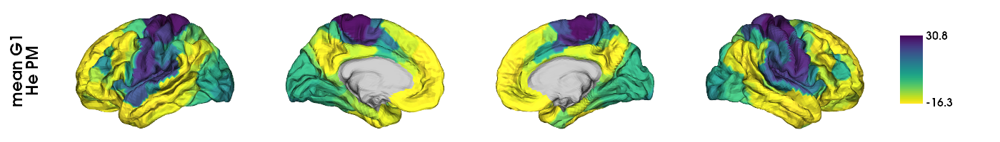

In [ ]:
### Build mean gradient

# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_He_PM = sum(fc_matrices_He_PM)/len(fc_matrices_He_PM)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_He_PM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_He_PM = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_He_PM.fit(mean_fc_matrix_He_PM)

# mean G1
mean_fc_G1_He_PM = mean_fc_grad_He_PM.gradients_[:,0]



### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
#And the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_He_PM_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_He_PM, seven_networks=False)



### Plot on hemispheres

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_He_PM_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range =,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'He_PM_mean_G1.png')

plotted_hemispheres

## Aligned gradients

In [ ]:
compute_aligned_grad_He_PM = compute_aligned_gradients(fc_matrices_He_PM, mean_fc_grad_He_PM.gradients_) 

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_He_PM_G1 = compute_aligned_grad_He_PM['array_aligned_G1']

### Export gradient to csv for R and dispersion analyses

In [ ]:
# fmt = decimals, 
# header = str(list(range(1,401)))[1:-1] ->header = 1 to 400 (without the first and last string letter because it's the [] of the list -> only use for R export, np.genfromtxt will read it as an additional line which is wrong
# comments = empty because otherwise gives a #


np.savetxt(resdir+'array_aligned_fc_He_PM_G1.csv', array_aligned_fc_He_PM_G1, delimiter=',', fmt = '%.16g', comments = '')

## Variability in gradients

### Visualize daily gradients

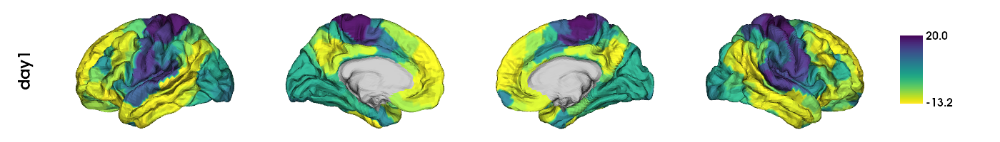

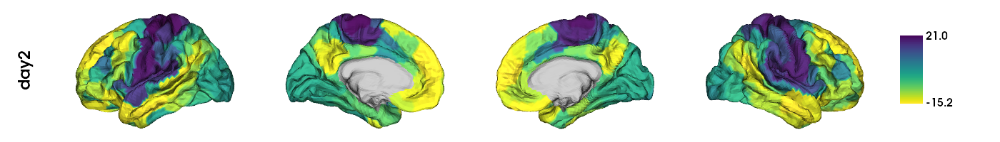

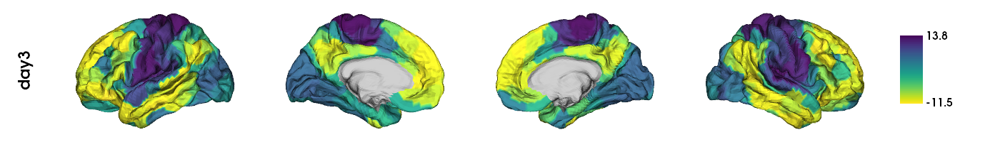

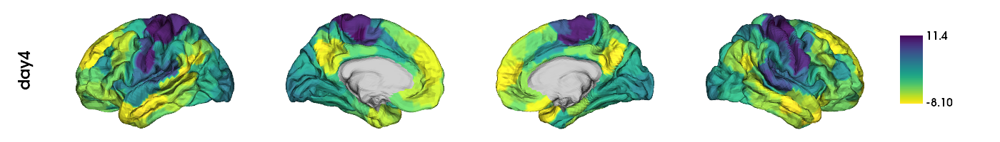

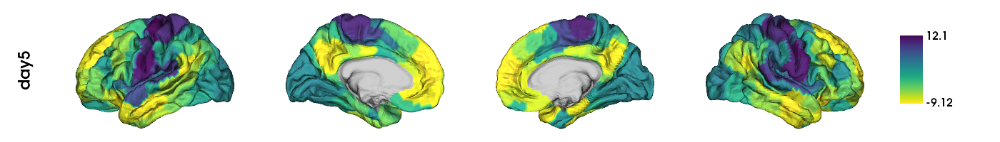

...

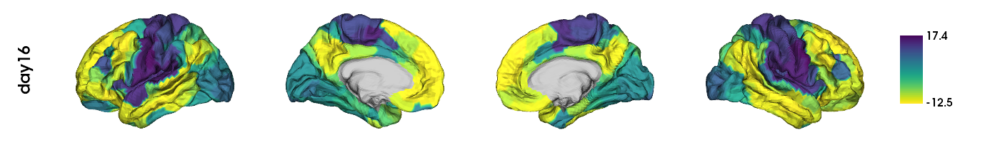

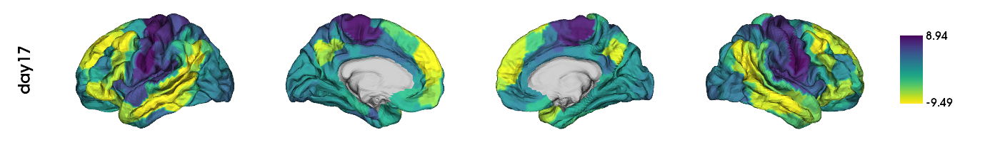

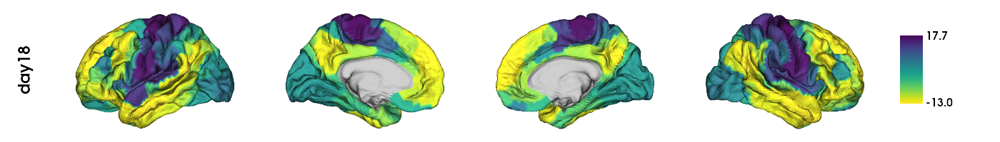

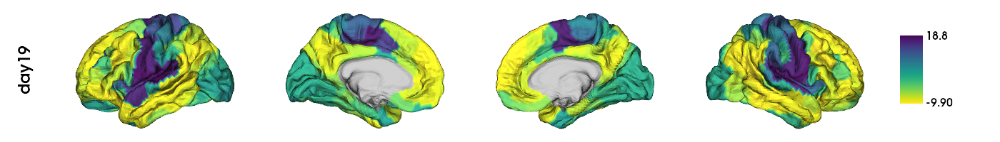

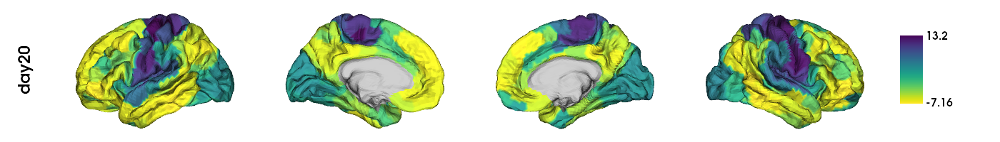

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# define handles list to hold the 30 days data to plot on hemispheres
handles = []
    
    
# iterate over  MC cycle days
for i in range(len(array_aligned_fc_He_PM_G1)):
    
    # transform to fs5 for plotting
    fc_He_PM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = array_aligned_fc_He_PM_G1[i], seven_networks=False)
    
    # plot on hemispheres
    plotted_hemispheres_byday = plot_hemispheres(
        surf_lh, 
        surf_rh, 
        array_name = fc_He_PM_G1_fs5, 
        embed_nb = True, 
        size = (1400,200), 
        cmap = 'viridis_r', 
        color_bar = True, 
        #color_range = color_range_t,
        nan_color = (0.7, 0.7, 0.7, 1),
        label_text = ["day"+str(i+1)],
        zoom = 1.45)

    # append current day to handles
    handles.append(plotted_hemispheres_byday)
    
# display handles
display(*handles)

### Quantify variability

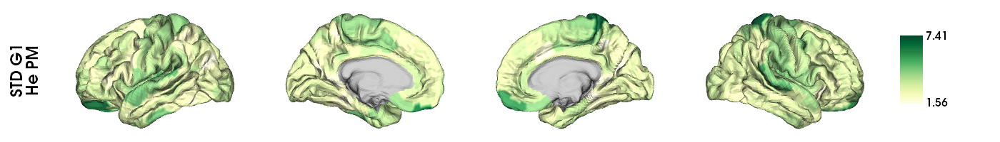

In [ ]:
# compute the standard deviation across days per parcel
std_fc_He_PM_G1 = np.std(array_aligned_fc_He_PM_G1, axis=0)


## Plot

# convert to fs5 for plotting
std_fc_He_PM_G1_fs5 = schaefer400_to_fs5(schaefer400_data = std_fc_He_PM_G1, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


# plot hemispheres
plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = std_fc_He_PM_G1_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'YlGn', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["STD G1\nHe PM"],
    zoom = 1.45)

plotted_hemispheres

2023-10-04 23:58:18,623 - matplotlib.legend - WARNING - No handles with labels found to put in legend.


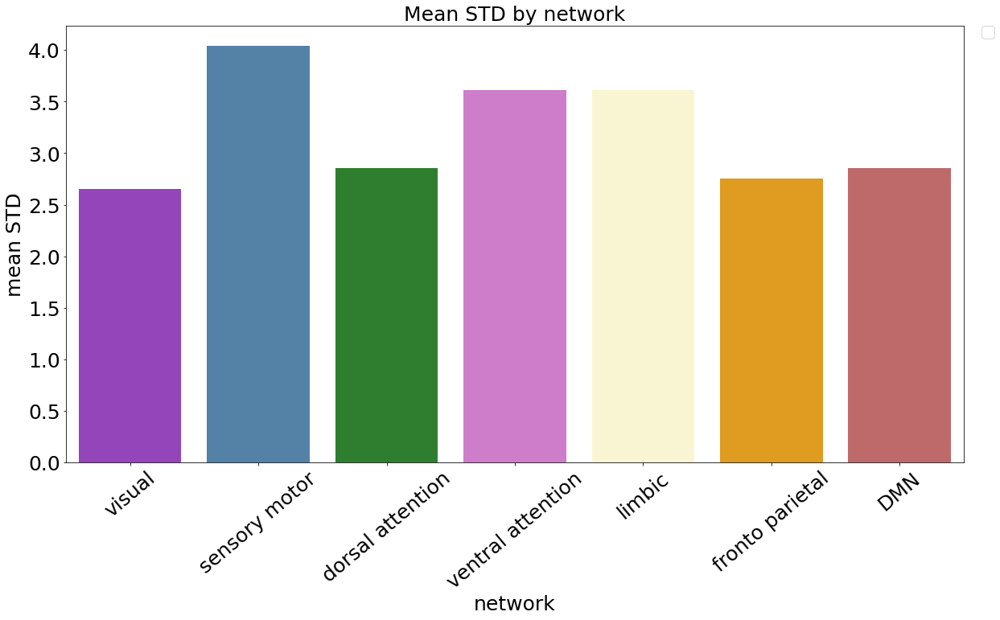

In [ ]:
### Shape data in a plottable format

# lists that will contain std per sex per network
visual_std_grad = []
sensorimotor_std_grad = []
dorsalattention_std_grad = []
ventralattention_std_grad = []
limbic_std_grad = []
frontoparietal_std_grad = []
dmn_std_grad = []


# iterating over 400 parcels (of std) 
for i in range(len(std_fc_He_PM_G1)):

    # append given parcel's std gradient loading to the corresponding list depending on what network it belongs to (and by sex)
    if yeo_17_2_7_networks_array_labels[i] == 'visual':
        visual_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'sensory motor':
        sensorimotor_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'dorsal attention':
        dorsalattention_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'ventral attention':
        ventralattention_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'limbic':
        limbic_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'fronto parietal':
        frontoparietal_std_grad.append(std_fc_He_PM_G1[i])

    elif yeo_17_2_7_networks_array_labels[i] == 'DMN':
        dmn_std_grad.append(std_fc_He_PM_G1[i])
        
        

# shape specifically for sns plotting

dict_std_fc_G1 = {'visual': statistics.mean(visual_std_grad), 
                  'sensory motor': statistics.mean(sensorimotor_std_grad), 
                  'dorsal attention': statistics.mean(dorsalattention_std_grad), 
                  'ventral attention': statistics.mean(ventralattention_std_grad), 
                  'limbic': statistics.mean(limbic_std_grad),
                  'fronto parietal': statistics.mean(frontoparietal_std_grad), 
                  'DMN': statistics.mean(dmn_std_grad), 
                  'id': [1]*30}

df_std_fc_G1 = pd.DataFrame(dict_std_fc_G1)

df_std_fc_G1_long = pd.melt(df_std_fc_G1, id_vars=['id'], value_vars=['visual', 'sensory motor', 'dorsal attention', 'ventral attention', 'limbic', 'fronto parietal', 'DMN'], var_name='network', value_name='mean sd')



### Plot 

fig, ax = plt.subplots(figsize=(20,10));

ax = sns.barplot(data=df_std_fc_G1_long, x='network', y='mean sd', palette=palette_labeled_networks)


ax.set_title('Mean STD by network', fontsize=25);
ax.set_xlabel('network', fontsize=25);
ax.set_ylabel('mean STD', fontsize=25);
ax.tick_params(labelsize=25);

ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="center")
ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


## MixedLM (He PM)

### Run model - hormones

In [ ]:
lmer_res_He_PM = {'parcel' : [], 'testosterone_t_val': [], 'testosterone_p_val': [], 'cortisol_t_val': [], 'cortisol_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_PM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'testosterone': hormones_28He_PM.z_total_testosterone_saliva, 'cortisol': hormones_28He_PM.z_cortisol_saliva}),  # fixed effects (covariate)
        groups = hormones_28He_PM.time,  # the same across timepoints
        exog_re = None,  # covariates random effects (should be hormones_28He_PM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results of estradiol, progesterone, estradiol*progesterone effects (via indices) 
    lmer_res_He_PM['parcel'].append(i)
    lmer_res_He_PM['testosterone_t_val'].append(results.tvalues['testosterone'])
    lmer_res_He_PM['testosterone_p_val'].append(results.pvalues['testosterone'])
    lmer_res_He_PM['cortisol_t_val'].append(results.tvalues['cortisol'])
    lmer_res_He_PM['cortisol_p_val'].append(results.pvalues['cortisol']) 

lmer_res_He_PM['testosterone_q_val'] = fdrcorrection(lmer_res_He_PM['testosterone_p_val'], alpha=0.05)[1]
lmer_res_He_PM['cortisol_q_val'] = fdrcorrection(lmer_res_He_PM['cortisol_p_val'], alpha=0.05)[1]

lmer_res_He_PM = pd.DataFrame(lmer_res_He_PM)

In [ ]:
lmer_res_He_PM

,parcel,testosterone_t_val,testosterone_p_val,cortisol_t_val,cortisol_p_val,testosterone_q_val,cortisol_q_val
0,0,0.439118,0.660576,-1.113989,0.265284,0.996003,0.996804
1,1,0.029405,0.976542,-0.025561,0.979607,0.996003,0.996804
2,2,-0.408628,0.682813,3.204407,0.001353,0.996003,0.457021
3,3,0.729201,0.465879,-0.241779,0.808952,0.996003,0.996804
4,4,-0.307105,0.758763,1.884556,0.059490,0.996003,0.996804
...,...,...,...,...,...,...,...
395,395,-0.750342,0.453049,0.472119,0.636842,0.996003,0.996804
396,396,-0.457523,0.647295,0.221244,0.824903,0.996003,0.996804
397,397,-0.939312,0.347571,-0.587740,0.556707,0.996003,0.996804
398,398,-1.376593,0.168638,0.622613,0.533539,0.996003,0.996804


In [ ]:
np.where(np.array(lmer_res_He_PM.testosterone_q_val) < 0.05)[0].shape

(0,)

In [ ]:
np.where(np.array(lmer_res_He_PM.cortisol_q_val) < 0.05)[0].shape

(0,)

In [ ]:
np.isnan(lmer_res_He_PM.testosterone_p_val).any()

False

In [ ]:
np.isnan(lmer_res_He_PM.cortisol_p_val).any()

False

In [ ]:
np.argwhere(np.isnan(np.array(lmer_res_He_PM['testosterone_p_val'])))

array([], shape=(0, 1), dtype=int64)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [ ]:
testosterone_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.testosterone_t_val, seven_networks=False)
cortisol_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.cortisol_t_val, seven_networks=False)
testosterone_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.testosterone_q_val, seven_networks=False)
cortisol_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM.cortisol_q_val, seven_networks=False)

#### t-values for q < 0.05

In [ ]:
## find t-values

# testosterone

testosterone_fdr_corrected_tvals_fs5 = []

for i in range(len(testosterone_q_val_fs5)):
    if testosterone_q_val_fs5[i] <= 0.05:
        testosterone_fdr_corrected_tvals_fs5.append(testosterone_t_val_fs5[i])
    else:
        testosterone_fdr_corrected_tvals_fs5.append(float('nan'))
        
testosterone_fdr_corrected_tvals_fs5 = np.array(testosterone_fdr_corrected_tvals_fs5)



# cortisol

cortisol_fdr_corrected_tvals_fs5 = []

for i in range(len(cortisol_q_val_fs5)):
    if cortisol_q_val_fs5[i] <= 0.05:
        cortisol_fdr_corrected_tvals_fs5.append(cortisol_t_val_fs5[i])
    else:
        cortisol_fdr_corrected_tvals_fs5.append(float('nan'))
        
cortisol_fdr_corrected_tvals_fs5 = np.array(cortisol_fdr_corrected_tvals_fs5)

### Plot on hemispheres

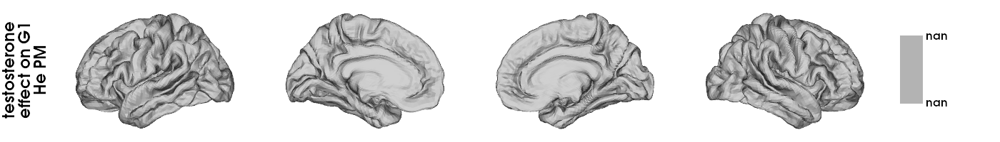

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = testosterone_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["testosterone\neffect on G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HePM_test_on_G1.png')

plotted_hemispheres

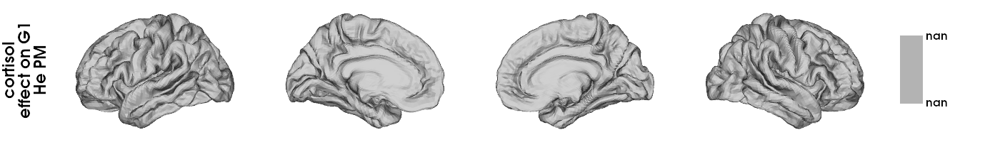

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = cortisol_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["cortisol\neffect on G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HePM_cort_on_G1.png')

plotted_hemispheres

### Run model - perceived stress

In [ ]:
lmer_res_He_PM_stress = {'parcel' : [], 'PSS_t_val': [], 'PSS_p_val': []}

for i in range(400):
    
    # define model
    model = sm.MixedLM(
        endog = array_aligned_fc_He_PM_G1.T[i],  # dependent variable
        exog = pd.DataFrame({'PSS': hormones_28He_PM.z_PSS}),  # fixed effects (covariate)
        groups = hormones_28He_PM.time,  # the same across timepoint
        exog_re = None,  # covariates random effects (should be hormones_28He_PM.session)
        exog_vc=None)

    # fit model
    results = model.fit()
    #results.summary()
    
    # save results 
    lmer_res_He_PM_stress['parcel'].append(i)
    lmer_res_He_PM_stress['PSS_t_val'].append(results.tvalues['PSS'])
    lmer_res_He_PM_stress['PSS_p_val'].append(results.pvalues['PSS'])

lmer_res_He_PM_stress['PSS_q_val'] = fdrcorrection(lmer_res_He_PM_stress['PSS_p_val'], alpha=0.05)[1]

lmer_res_He_PM_stress = pd.DataFrame(lmer_res_He_PM_stress)

In [ ]:
lmer_res_He_PM_stress

,parcel,PSS_t_val,PSS_p_val,PSS_q_val
0,0,-1.107322,0.268155,0.997175
1,1,-0.567223,0.570563,0.997175
2,2,0.947150,0.343562,0.997175
3,3,-0.239239,0.810921,0.997175
4,4,1.038767,0.298913,0.997175
...,...,...,...,...
395,395,-0.455511,0.648742,0.997175
396,396,-0.352622,0.724372,0.997175
397,397,0.623183,0.533164,0.997175
398,398,-0.455276,0.648911,0.997175


In [ ]:
np.where(np.array(lmer_res_He_PM_stress.PSS_q_val) < 0.05)[0].shape

(0,)

In [ ]:
np.isnan(lmer_res_He_PM_stress.PSS_p_val).any()

False

In [ ]:
np.where(np.isnan(lmer_res_He_PM_stress.PSS_p_val))

(array([], dtype=int64),)

### Reshape results for plotting

#### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network (used in brainspace plot hemispheres)

In [ ]:
PSS_t_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM_stress.PSS_t_val, seven_networks=False)
PSS_q_val_fs5 = schaefer400_to_fs5(schaefer400_data = lmer_res_He_PM_stress.PSS_q_val, seven_networks=False)

#### t-values for q < 0.05

In [ ]:
## find t-values

# PSS

PSS_fdr_corrected_tvals_fs5 = []

for i in range(len(PSS_q_val_fs5)):
    if PSS_q_val_fs5[i] <= 0.05:
        PSS_fdr_corrected_tvals_fs5.append(PSS_t_val_fs5[i])
    else:
        PSS_fdr_corrected_tvals_fs5.append(float('nan'))
        
PSS_fdr_corrected_tvals_fs5 = np.array(PSS_fdr_corrected_tvals_fs5)

### Plot on hemispheres

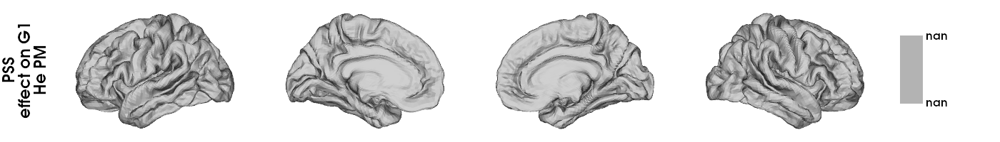

In [ ]:
# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = PSS_fdr_corrected_tvals_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'PiYG', 
    color_bar = True, 
    color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["PSS\neffect on G1\nHe PM"],
    zoom = 1.45,
    screenshot = False,
    filename = resdir_fig+'HePM_PSS_on_G1.png')

plotted_hemispheres

## Correlation hormone effects He AM and PM

In [ ]:
stats.spearmanr(lmer_res_He_AM.testosterone_t_val, lmer_res_He_PM.testosterone_t_val)

SpearmanrResult(correlation=0.5170065437908987, pvalue=1.0141776953982248e-28)

In [ ]:
stats.spearmanr(lmer_res_He_AM.cortisol_t_val, lmer_res_He_PM.cortisol_t_val)

SpearmanrResult(correlation=0.24527515796973728, pvalue=6.827276588304703e-07)

# Differences in variability

## Me vs He (PM)

### Colormap plotted hemispheres differences Levene FDR non-indicative → should be all blue

Number of parcels for which there males have a statistically significant larger variance than females: 168
Number of parcels for which there females have a statistically significant larger variance than males: 1
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 94
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.56; Females = 1.421
Maximum SD: Males = 7.412; Females = 4.916


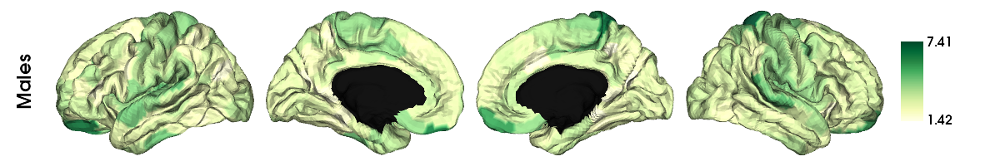

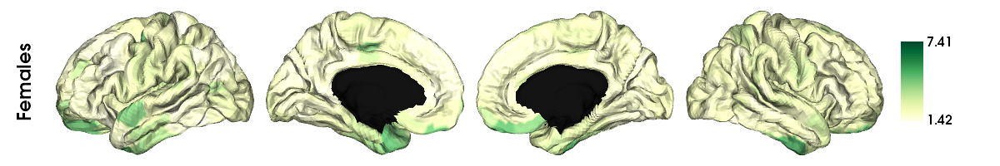

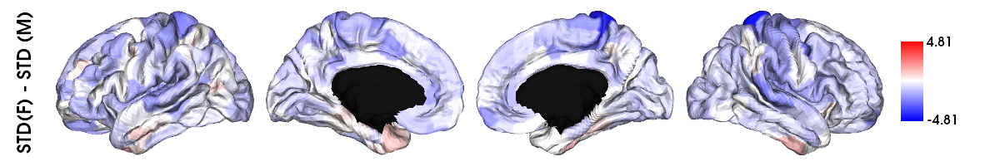

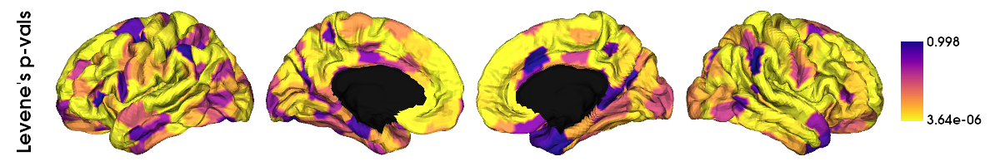

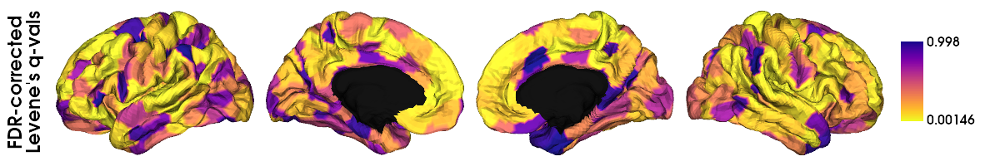

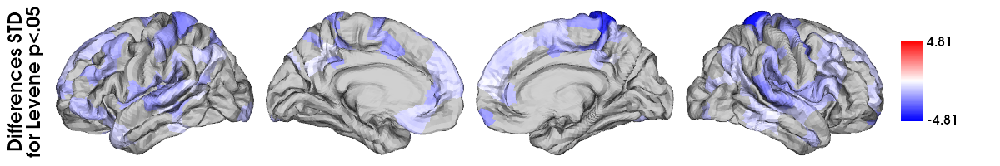

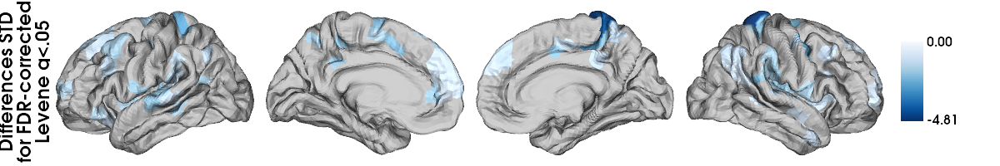

Number of significant parcels: 94

Number of significant parcels for males: 94
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 32 out of 77 (41.56%) -> 34.04% of overall significance
- DMN: 29 out of 46 (63.04%) -> 30.85% of overall significance
- dorsal attention: 4 out of 47 (8.51%) -> 4.26% of overall significance
- ventral attention: 22 out of 26 (84.62%) -> 23.4% of overall significance
- limbic: 0 out of 53 (0.0%) -> 0.0% of overall significance
- fronto parietal: 7 out of 90 (7.78%) -> 7.45% of overall significance





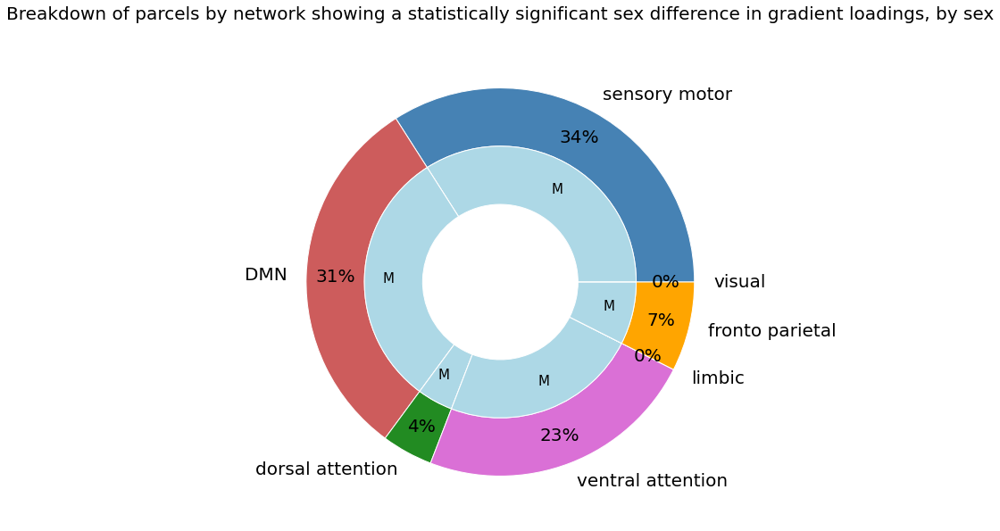

Number of significant parcels by sex:
visual - Male: 0, Female: 0
sensory motor - Male: 32, Female: 0
DMN - Male: 29, Female: 0
dorsal attention - Male: 4, Female: 0
ventral attention - Male: 22, Female: 0
limbic - Male: 0, Female: 0
fronto parietal - Male: 7, Female: 0





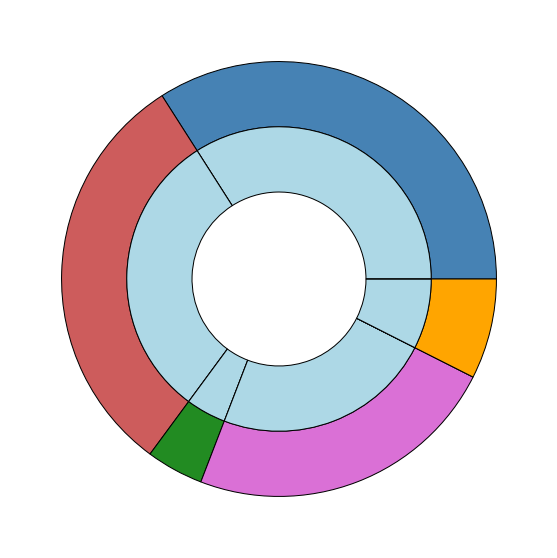

In [ ]:
diff_std_Me_He_PM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_PM_G1, subject_grad_F=array_aligned_fc_G1_excl26, sample_modality='Me_HePM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


## Me vs He (AM&PM)

### Colormap plotted hemispheres differences Levene FDR non-indicative → should be all blue

Number of parcels for which there males have a statistically significant larger variance than females: 163
Number of parcels for which there females have a statistically significant larger variance than males: 2
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 111
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 1

Minimum SD: Males = 1.574; Females = 1.421
Maximum SD: Males = 6.105; Females = 4.916


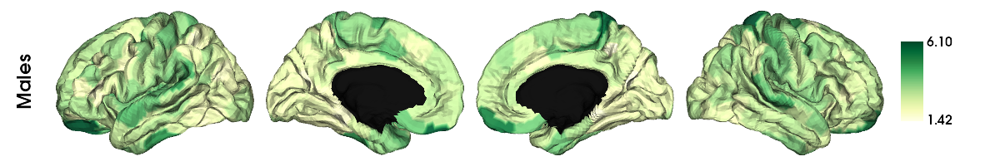

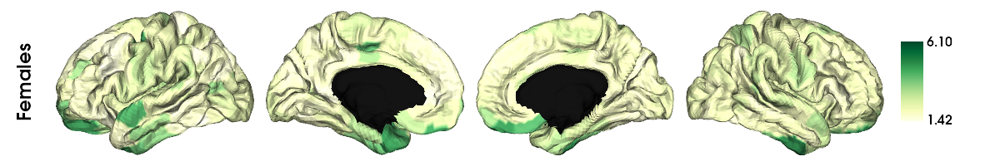

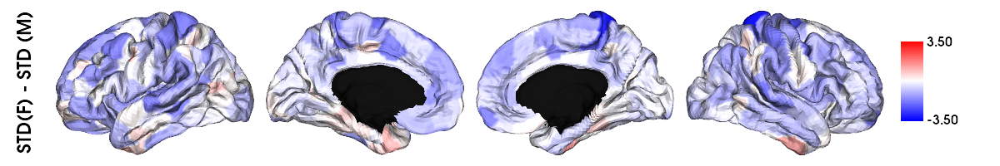

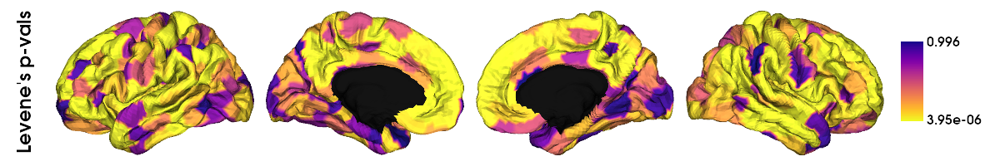

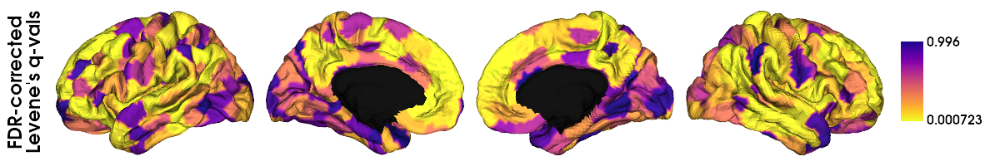

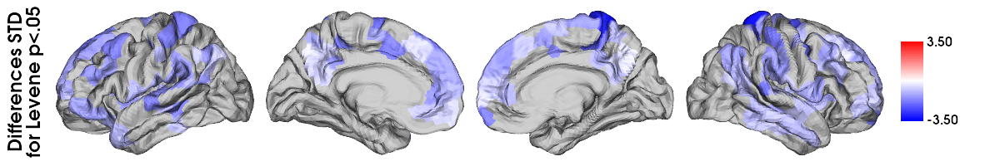

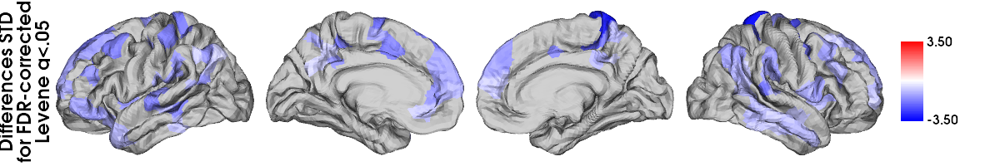

Number of significant parcels: 112

Number of significant parcels for males: 111
Number of significant parcels for females: 1

Number of significant parcels in each Yeo network (across sexes):
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 23 out of 77 (29.87%) -> 20.54% of overall significance
- DMN: 45 out of 46 (97.83%) -> 40.18% of overall significance
- dorsal attention: 5 out of 47 (10.64%) -> 4.46% of overall significance
- ventral attention: 24 out of 26 (92.31%) -> 21.43% of overall significance
- limbic: 2 out of 53 (3.77%) -> 1.79% of overall significance
- fronto parietal: 13 out of 90 (14.44%) -> 11.61% of overall significance





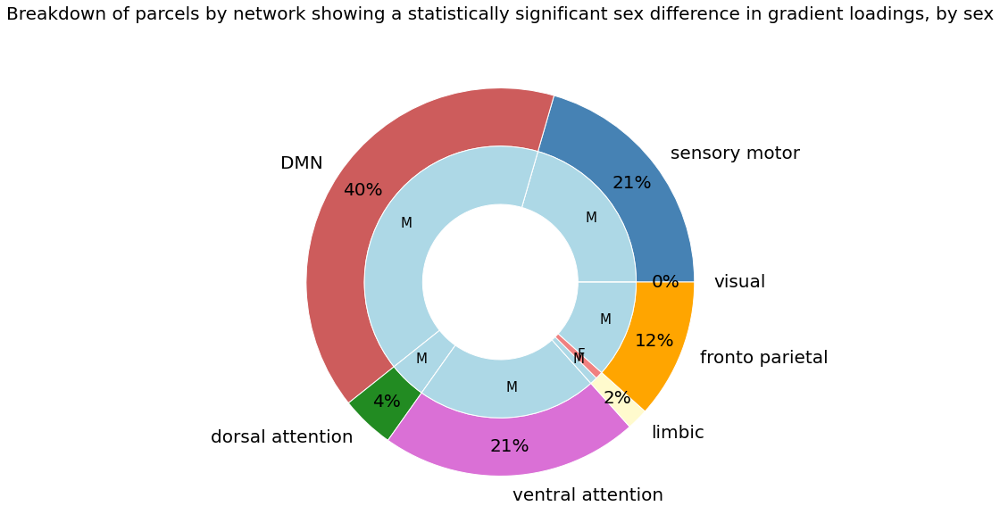

Number of significant parcels by sex:
visual - Male: 0, Female: 0
sensory motor - Male: 23, Female: 0
DMN - Male: 45, Female: 0
dorsal attention - Male: 5, Female: 0
ventral attention - Male: 24, Female: 0
limbic - Male: 1, Female: 1
fronto parietal - Male: 13, Female: 0





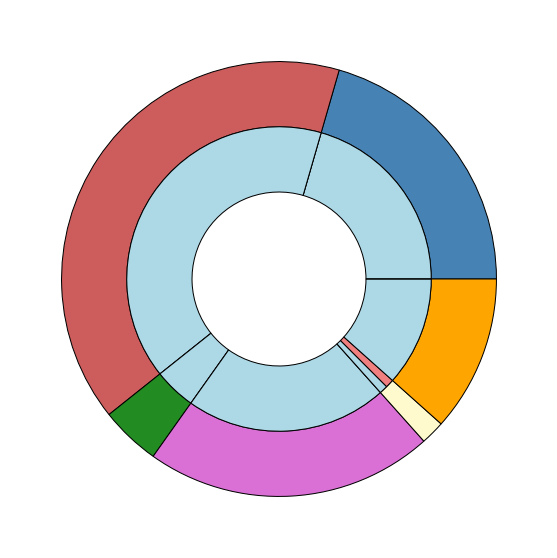

In [ ]:
diff_std_Me_He_PM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_G1, subject_grad_F=array_aligned_fc_G1_excl26, sample_modality='Me_He', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)


## Difference in variability between M and F when taking same number of datapoints for M & F (n=20)

### Make new aligned gradients for F

#### Exclude 10 equally-spaced datapoints from original 30-long array (including day 26 (index 25) given that needs to be excluded anyway)

In [ ]:
fc_matrices_n20 =  np.delete(fc_matrices, [1,4,7,10,13,16,19,22,25,28], axis = 0)

In [ ]:
fc_matrices_n20.shape

(20, 400, 400)

### Mean gradient

In [ ]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix_n20 = sum(fc_matrices_n20)/len(fc_matrices_n20)


## compute the mean gradients 

# GradientMaps function used to build the model parameters
#mean_fc_grad_excl26 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm', kernel='normalized_angle')
mean_fc_grad_n20 = GradientMaps(n_components = 10, random_state = 0, approach = 'dm')

# fit function used to compute the gradients
mean_fc_grad_n20.fit(mean_fc_matrix_n20)

# mean G1
mean_fc_G1_n20 = mean_fc_grad_n20.gradients_[:,0]

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/gradient/embedding.py:70: UserWarning: Affinity is not symmetric. Making symmetric.
  warnings.warn('Affinity is not symmetric. Making symmetric.')


#### Plot on hemispheres

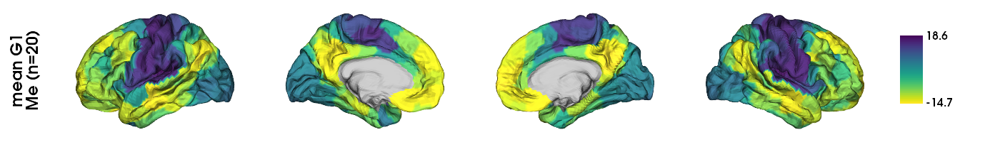

In [ ]:
### Transform to fsaverage space for plotting - given that Scahefer 400 17 network parcellation order != Schaefer 400 7 network 
# and the only options for plotting in brainspace are either Schaefer 400 (7 networks) or fsaverage5

mean_fc_G1_n20_fs5 = schaefer400_to_fs5(schaefer400_data = mean_fc_G1_n20, seven_networks=False)

# need to plot right and left hemispheres with fsaverage mesh (instead of loading conte69) because I transformed the data in fsaverage5 (already in format: 20484 vertices) unlike conte69 (64984 vertices)
mesh_paths = {
   'L': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_left'],
   'R': nilearn.datasets.fetch_surf_fsaverage('fsaverage5')['pial_right']
}
surf_lh = brainspace.mesh.mesh_io.read_surface(mesh_paths['L'])
surf_rh = brainspace.mesh.mesh_io.read_surface(mesh_paths['R'])


plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_fc_G1_n20_fs5, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = 'viridis_r', 
    color_bar = True, 
    #color_range = color_range_t,
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean G1\nMe (n=20)"],
    zoom = 1.45,
    screenshot = False)

plotted_hemispheres

### Aligned gradients

In [ ]:
compute_aligned_grad_n20 = compute_aligned_gradients(fc_matrices_n20, mean_fc_grad_n20.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1_n20 = compute_aligned_grad_n20['array_aligned_G1']

In [ ]:
array_aligned_fc_G1_n20.shape

(20, 400)

### Differences in variability

Number of parcels for which there males have a statistically significant larger variance than females: 69
Number of parcels for which there females have a statistically significant larger variance than males: 2
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 0
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 0

Minimum SD: Males = 1.399; Females = 1.214
Maximum SD: Males = 5.247; Females = 5.043


/tmp/ipykernel_4616/1849898711.py:92: RuntimeWarning: All-NaN slice encountered
  color_range_custom = (0, np.nanmax(std_grad_fdr_corr_levene_sig_sexdiff))
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


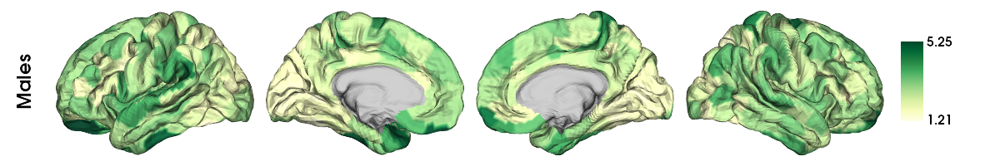

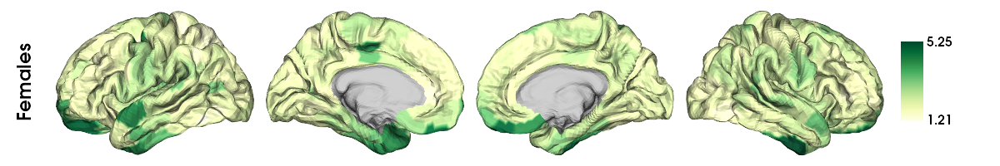

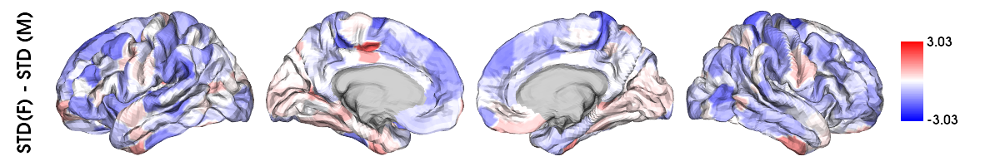

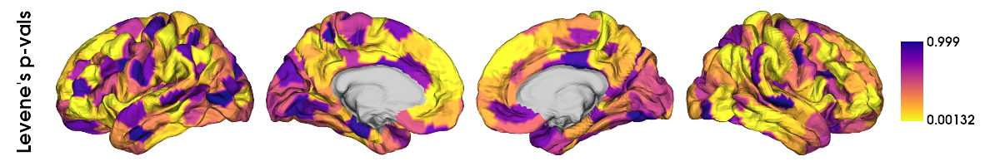

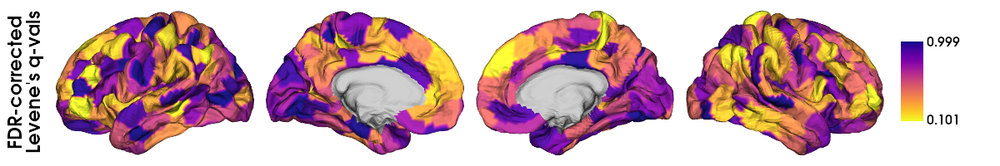

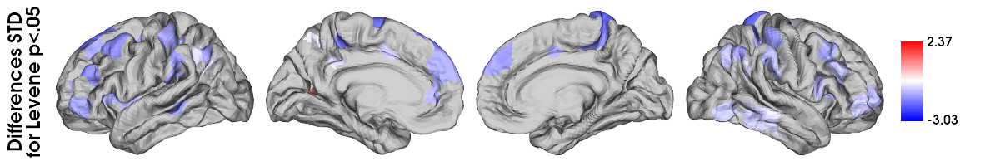

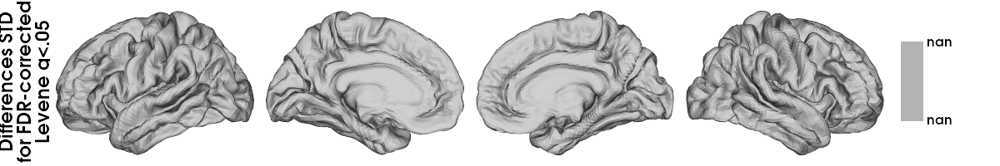

Number of significant parcels: 0

Number of significant parcels for males: 0
Number of significant parcels for females: 0

Number of significant parcels in each Yeo network (across sexes):


ZeroDivisionError: division by zero

In [ ]:
diff_std_Me_He_AM = variability_parcel_std(subject_grad_M=array_aligned_fc_He_AM_G1, subject_grad_F=array_aligned_fc_G1_n20, sample_modality='Me_HeAM', plot_in_fsa5 = True, save_plots = False, output_dir = resdir_fig)
